<a href="https://colab.research.google.com/github/gowthamkrishna555/FinalYear/blob/main/FinalYear.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: Error: credential propagation was unsuccessful

Saving Screenshot 2024-02-28 100138.png to Screenshot 2024-02-28 100138.png
Saving Screenshot 2024-02-28 100105.png to Screenshot 2024-02-28 100105 (1).png


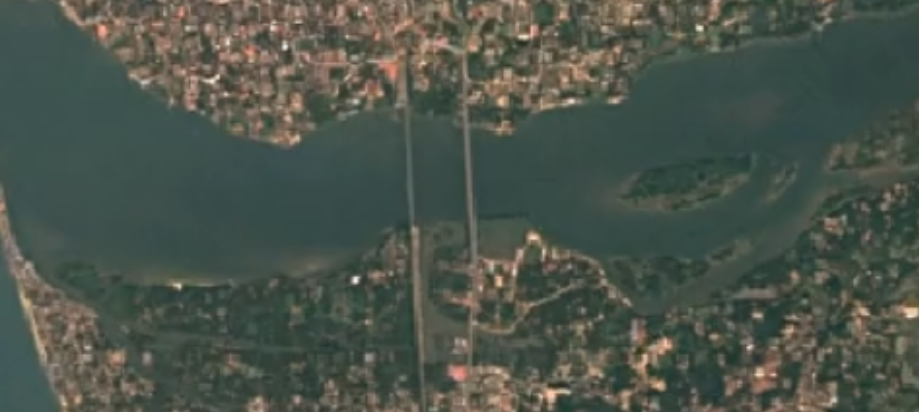

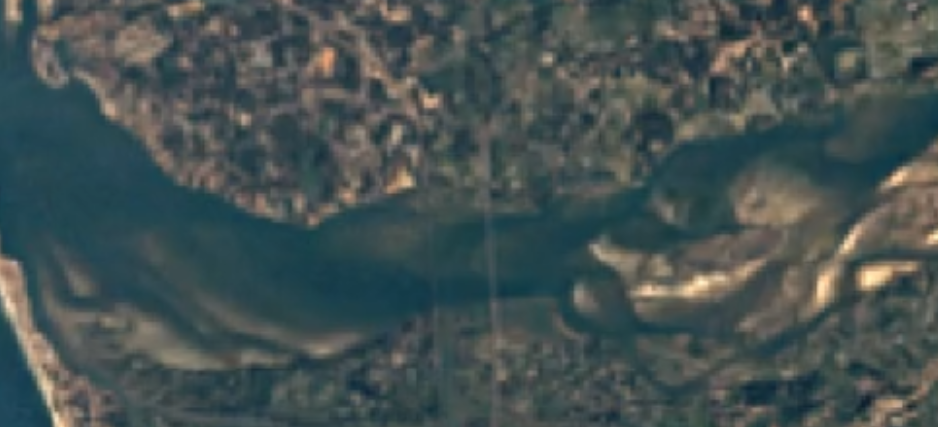

error: OpenCV(4.8.0) /io/opencv/modules/core/src/arithm.cpp:647: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'


In [ ]:
import cv2
import numpy as np
from skimage import segmentation, color
import matplotlib.pyplot as plt
from google.colab import files
from IPython.display import Image, display

# Function to calculate the rate of difference
def calculate_difference_rate(image1, image2):
    total_pixels = image1.size
    different_pixels = np.count_nonzero(image1 != image2)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA)
def obia(image1, image2):
    # Convert images to grayscale
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Image differencing
    difference_image = cv2.absdiff(gray1, gray2)

    # Thresholding
    _, thresholded = cv2.threshold(difference_image, 30, 255, cv2.THRESH_BINARY)

    # Object-based segmentation
    labels = segmentation.slic(image2, compactness=30, n_segments=1000)
    segmented_image = color.label2rgb(labels, image=image2, kind='avg')

    # Masking the segmented image using the thresholded difference
    segmented_image[thresholded == 255] = [255, 0, 0]  # Highlighting changes in red

    # Calculate and print the rate of difference
    difference_rate = calculate_difference_rate(gray1, gray2)
    print(f"Rate of Difference: {difference_rate:.2f}%")

    # Display the images
    plt.figure(figsize=(12, 6))
    plt.subplot(131), plt.imshow(gray1, cmap='gray'), plt.title('Image 1')
    plt.subplot(132), plt.imshow(gray2, cmap='gray'), plt.title('Image 2')
    plt.subplot(133), plt.imshow(segmented_image), plt.title('Difference Image')
    plt.show()

# Upload images using Google Colab's file upload
uploaded = files.upload()

# Display the uploaded images
for filename in uploaded.keys():
    display(Image(filename))

# Check if two images are uploaded
if len(uploaded) == 2:
    # Call the OBIA function with the uploaded images
    obia(cv2.imread(list(uploaded.keys())[0]), cv2.imread(list(uploaded.keys())[1]))
else:
    print("Please upload two images.")


Saving Screenshot 2024-02-28 100138.png to Screenshot 2024-02-28 100138 (1).png
Saving Screenshot 2024-02-28 100105.png to Screenshot 2024-02-28 100105 (2).png


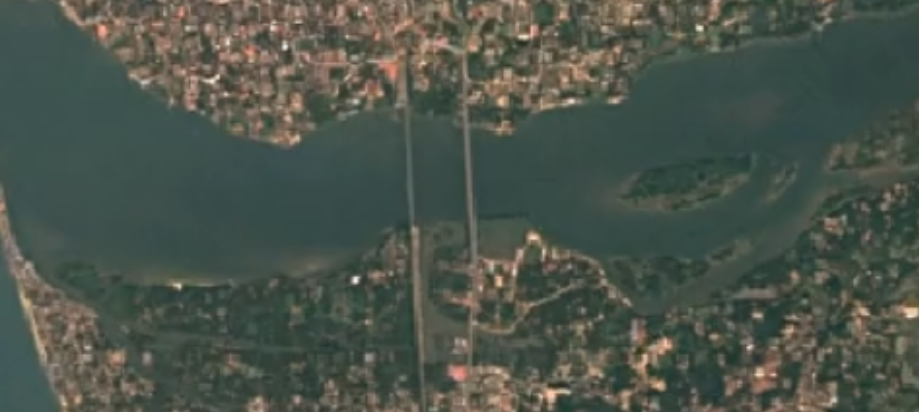

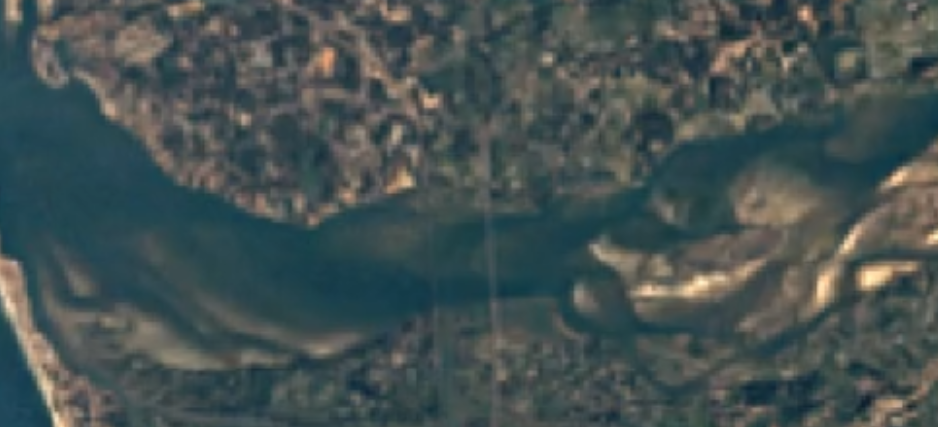

Rate of Difference: 98.48%


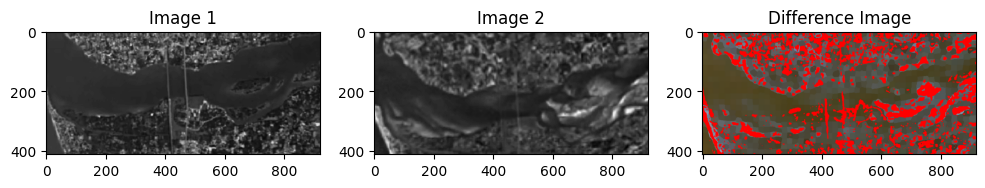

In [ ]:
import cv2
import numpy as np
from skimage import segmentation, color
import matplotlib.pyplot as plt
from google.colab import files
from IPython.display import Image, display

# Function to calculate the rate of difference
def calculate_difference_rate(image1, image2):
    total_pixels = image1.size
    different_pixels = np.count_nonzero(image1 != image2)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA)
def obia(image1, image2):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Convert images to grayscale
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Image differencing
    difference_image = cv2.absdiff(gray1, gray2)

    # Thresholding
    _, thresholded = cv2.threshold(difference_image, 30, 255, cv2.THRESH_BINARY)

    # Object-based segmentation
    labels = segmentation.slic(image2, compactness=30, n_segments=1000)
    segmented_image = color.label2rgb(labels, image=image2, kind='avg')

    # Masking the segmented image using the thresholded difference
    segmented_image[thresholded == 255] = [255, 0, 0]  # Highlighting changes in red

    # Calculate and print the rate of difference
    difference_rate = calculate_difference_rate(gray1, gray2)
    print(f"Rate of Difference: {difference_rate:.2f}%")

    # Display the images
    plt.figure(figsize=(12, 6))
    plt.subplot(131), plt.imshow(gray1, cmap='gray'), plt.title('Image 1')
    plt.subplot(132), plt.imshow(gray2, cmap='gray'), plt.title('Image 2')
    plt.subplot(133), plt.imshow(segmented_image), plt.title('Difference Image')
    plt.show()

# Upload images using Google Colab's file upload
uploaded = files.upload()

# Display the uploaded images
for filename in uploaded.keys():
    display(Image(filename))

# Check if two images are uploaded
if len(uploaded) == 2:
    # Call the OBIA function with the uploaded images
    obia(cv2.imread(list(uploaded.keys())[0]), cv2.imread(list(uploaded.keys())[1]))
else:
    print("Please upload two images.")


Rate of Difference: 98.48%


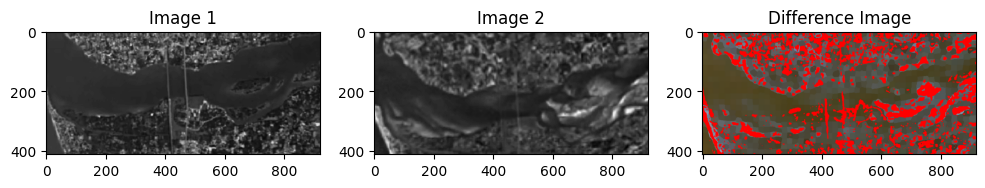

In [ ]:
import cv2
import numpy as np
from skimage import segmentation, color
import matplotlib.pyplot as plt
import os

# Function to calculate the rate of difference
def calculate_difference_rate(image1, image2):
    total_pixels = image1.size
    different_pixels = np.count_nonzero(image1 != image2)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA)
def obia(image1, image2):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Convert images to grayscale
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Image differencing
    difference_image = cv2.absdiff(gray1, gray2)

    # Thresholding
    _, thresholded = cv2.threshold(difference_image, 30, 255, cv2.THRESH_BINARY)

    # Object-based segmentation
    labels = segmentation.slic(image2, compactness=30, n_segments=1000)
    segmented_image = color.label2rgb(labels, image=image2, kind='avg')

    # Masking the segmented image using the thresholded difference
    segmented_image[thresholded == 255] = [255, 0, 0]  # Highlighting changes in red

    # Calculate and print the rate of difference
    difference_rate = calculate_difference_rate(gray1, gray2)
    print(f"Rate of Difference: {difference_rate:.2f}%")

    # Display the images
    plt.figure(figsize=(12, 6))
    plt.subplot(131), plt.imshow(gray1, cmap='gray'), plt.title('Image 1')
    plt.subplot(132), plt.imshow(gray2, cmap='gray'), plt.title('Image 2')
    plt.subplot(133), plt.imshow(segmented_image), plt.title('Difference Image')
    plt.show()

# Specify the paths to the two folders containing images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List all files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.endswith(('.jpg', '.png'))]
image_files2 = [f for f in os.listdir(folder_path2) if f.endswith(('.jpg', '.png'))]

# Process all pairs of images from each folder
for image1, image2 in zip(image_files1, image_files2):
    image1_path = os.path.join(folder_path1, image1)
    image2_path = os.path.join(folder_path2, image2)

    # Call the OBIA function with the pair of images
    obia(cv2.imread(image1_path), cv2.imread(image2_path))


Rate of Difference: 98.48%


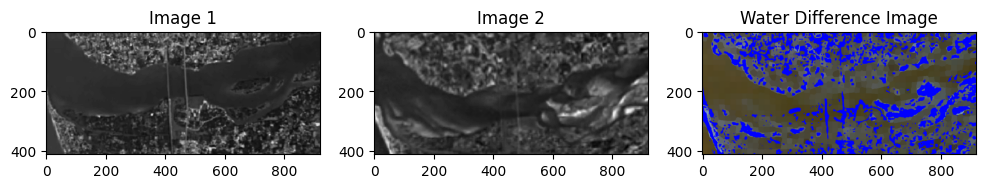

In [ ]:
import cv2
import numpy as np
from skimage import segmentation, color
import matplotlib.pyplot as plt
import os

# Function to calculate the rate of difference
def calculate_difference_rate(image1, image2):
    total_pixels = image1.size
    different_pixels = np.count_nonzero(image1 != image2)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA)
def obia(image1, image2):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Convert images to grayscale
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Image differencing
    difference_image = cv2.absdiff(gray1, gray2)

    # Thresholding
    _, thresholded = cv2.threshold(difference_image, 30, 255, cv2.THRESH_BINARY)

    # Use SLIC for segmentation
    labels = segmentation.slic(image2, compactness=30, n_segments=1000)

    # Masking the segmented image using the thresholded difference
    water_mask = np.zeros_like(thresholded)
    water_mask[thresholded == 255] = 1  # Set water regions to 1

    # Highlight water changes in blue
    water_highlighted = color.label2rgb(labels, image=image2, kind='avg')
    water_highlighted[water_mask == 1] = [0, 0, 255]  # Highlight water changes in blue

    # Calculate and print the rate of difference
    difference_rate = calculate_difference_rate(gray1, gray2)
    print(f"Rate of Difference: {difference_rate:.2f}%")

    # Display the images
    plt.figure(figsize=(12, 6))
    plt.subplot(131), plt.imshow(gray1, cmap='gray'), plt.title('Image 1')
    plt.subplot(132), plt.imshow(gray2, cmap='gray'), plt.title('Image 2')
    plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
    plt.show()

# Specify the paths to the two folders containing images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List all files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.endswith(('.jpg', '.png'))]
image_files2 = [f for f in os.listdir(folder_path2) if f.endswith(('.jpg', '.png'))]

# Process all pairs of images from each folder
for image1, image2 in zip(image_files1, image_files2):
    image1_path = os.path.join(folder_path1, image1)
    image2_path = os.path.join(folder_path2, image2)

    # Call the OBIA function with the pair of images
    obia(cv2.imread(image1_path), cv2.imread(image2_path))


Rate of Water Difference: 23.46%


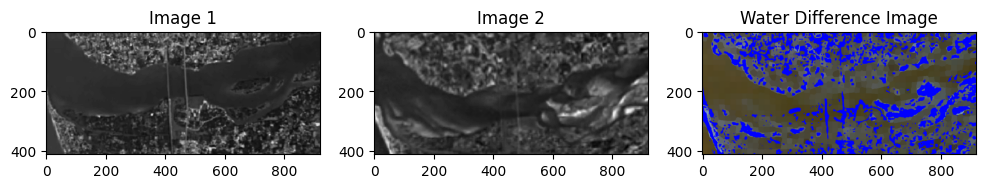

AttributeError: 'NoneType' object has no attribute 'shape'

In [ ]:
import cv2
import numpy as np
from skimage import segmentation, color
import matplotlib.pyplot as plt
import os

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 1)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA)
def obia(image1, image2):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Convert images to grayscale
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Image differencing
    difference_image = cv2.absdiff(gray1, gray2)

    # Thresholding
    _, thresholded = cv2.threshold(difference_image, 30, 255, cv2.THRESH_BINARY)

    # Use SLIC for segmentation
    labels = segmentation.slic(image2, compactness=30, n_segments=1000)

    # Masking the segmented image using the thresholded difference
    water_mask = np.zeros_like(thresholded)
    water_mask[thresholded == 255] = 1  # Set water regions to 1

    # Highlight water changes in blue
    water_highlighted = color.label2rgb(labels, image=image2, kind='avg')
    water_highlighted[water_mask == 1] = [0, 0, 255]  # Highlight water changes in blue

    # Calculate and print the rate of difference for water
    water_difference_rate = calculate_water_difference_rate(water_mask)
    print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    # Display the images
    plt.figure(figsize=(12, 6))
    plt.subplot(131), plt.imshow(gray1, cmap='gray'), plt.title('Image 1')
    plt.subplot(132), plt.imshow(gray2, cmap='gray'), plt.title('Image 2')
    plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
    plt.show()

# Specify the paths to the two folders containing images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List all files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.endswith(('.jpg', '.png','.tiff'))]
image_files2 = [f for f in os.listdir(folder_path2) if f.endswith(('.jpg', '.png','.tiff'))]

# Process all pairs of images from each folder
for image1, image2 in zip(image_files1, image_files2):
    image1_path = os.path.join(folder_path1, image1)
    image2_path = os.path.join(folder_path2, image2)

    # Call the OBIA function with the pair of images
    obia(cv2.imread(image1_path), cv2.imread(image2_path))


Rate of Water Difference: 23.46%


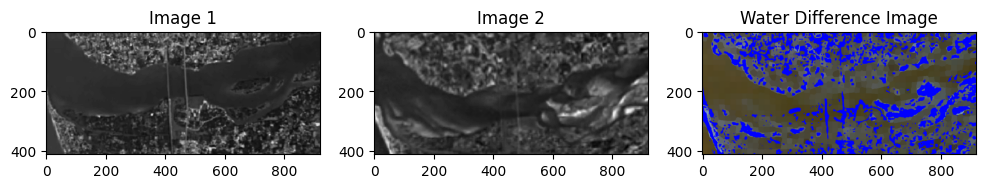

ValueError: test_size=0 should be either positive and smaller than the number of samples 1 or a float in the (0, 1) range

In [ ]:
import cv2
import numpy as np
from skimage import segmentation, color
import matplotlib.pyplot as plt
import os
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 1)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA)
def obia(image1, image2):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Convert images to grayscale
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Image differencing
    difference_image = cv2.absdiff(gray1, gray2)

    # Thresholding
    _, thresholded = cv2.threshold(difference_image, 30, 255, cv2.THRESH_BINARY)

    # Use SLIC for segmentation
    labels = segmentation.slic(image2, compactness=30, n_segments=1000)

    # Masking the segmented image using the thresholded difference
    water_mask = np.zeros_like(thresholded)
    water_mask[thresholded == 255] = 1  # Set water regions to 1

    # Highlight water changes in blue
    water_highlighted = color.label2rgb(labels, image=image2, kind='avg')
    water_highlighted[water_mask == 1] = [0, 0, 255]  # Highlight water changes in blue

    # Calculate and print the rate of difference for water
    water_difference_rate = calculate_water_difference_rate(water_mask)
    print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    # Display the images
    plt.figure(figsize=(12, 6))
    plt.subplot(131), plt.imshow(gray1, cmap='gray'), plt.title('Image 1')
    plt.subplot(132), plt.imshow(gray2, cmap='gray'), plt.title('Image 2')
    plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
    plt.show()

    return difference_image, water_difference_rate

# Specify the paths to the two folders containing images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List all files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.endswith(('.jpg', '.png'))]
image_files2 = [f for f in os.listdir(folder_path2) if f.endswith(('.jpg', '.png'))]

# Create lists to store data for training
X_train_images = []
y_train_labels = []

# Process all pairs of images from each folder
for image1, image2 in zip(image_files1, image_files2):
    image1_path = os.path.join(folder_path1, image1)
    image2_path = os.path.join(folder_path2, image2)

    # Call the OBIA function with the pair of images
    difference_image, water_difference_rate = obia(cv2.imread(image1_path), cv2.imread(image2_path))

    # Append data to the training lists
    X_train_images.append(difference_image)
    y_train_labels.append(water_difference_rate)

# Convert lists to numpy arrays
X_train_images = np.array(X_train_images)
y_train_labels = np.array(y_train_labels)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_train_images, y_train_labels, test_size=0.2, random_state=42)

# CNN Model
model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(height, width, channels)),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dense(1)  # Regression task, no activation function
])

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))


In [ ]:
pip install folium


Rate of Water Difference: 23.46%


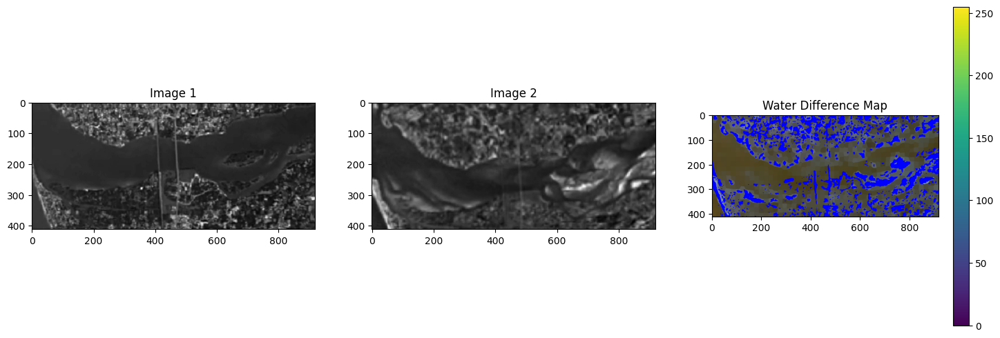

In [ ]:
import cv2
import numpy as np
from skimage import segmentation, color
import matplotlib.pyplot as plt
import os
import folium
from folium import plugins

# Function to perform object-based image analysis (OBIA) and create Folium map with difference overlay
def obia(image1, image2):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Convert images to grayscale
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Image differencing
    difference_image = cv2.absdiff(gray1, gray2)

    # Thresholding
    _, thresholded = cv2.threshold(difference_image, 30, 255, cv2.THRESH_BINARY)

    # Use SLIC for segmentation
    labels = segmentation.slic(image2, compactness=30, n_segments=1000)

    # Masking the segmented image using the thresholded difference
    water_mask = np.zeros_like(thresholded)
    water_mask[thresholded == 255] = 1  # Set water regions to 1

    # Highlight water changes in blue
    water_highlighted = color.label2rgb(labels, image=image2, kind='avg')
    water_highlighted[water_mask == 1] = [0, 0, 255]  # Highlight water changes in blue

    # Calculate and print the rate of difference for water
    water_difference_rate = calculate_water_difference_rate(water_mask)
    print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    # Display the images and difference map
    plt.figure(figsize=(18, 6))

    plt.subplot(131), plt.imshow(gray1, cmap='gray'), plt.title('Image 1')
    plt.subplot(132), plt.imshow(gray2, cmap='gray'), plt.title('Image 2')

    plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Map')
    plt.colorbar()  # Add a colorbar to show the scale of differences

    plt.show()

    # Create a Folium map
    map_center = [np.mean(image1.shape[0:2]) / 2, np.mean(image1.shape[0:2]) / 2]
    folium_map = folium.Map(location=map_center, zoom_start=12)

    # Create a Folium image overlay
    difference_overlay = folium.raster_layers.ImageOverlay(
        image=water_highlighted,
        bounds=[[0, 0], [image1.shape[0], image1.shape[1]]],
        opacity=0.7,
        colormap=lambda x: (0, 0, 255, x),  # Blue colormap
    )

    difference_overlay.add_to(folium_map)

    # Save the map to an HTML file
    folium_map.save("difference_map.html")

# Specify the paths to the two folders containing images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List all files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.endswith(('.jpg', '.png'))]
image_files2 = [f for f in os.listdir(folder_path2) if f.endswith(('.jpg', '.png'))]

# Process all pairs of images from each folder
for image1, image2 in zip(image_files1, image_files2):
    image1_path = os.path.join(folder_path1, image1)
    image2_path = os.path.join(folder_path2, image2)

    # Call the OBIA function with the pair of images
    obia(cv2.imread(image1_path), cv2.imread(image2_path))


In [ ]:
import cv2
import numpy as np
from skimage import segmentation, color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 1)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA)
def obia(image1, image2):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Convert images to grayscale
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Image differencing
    difference_image = cv2.absdiff(gray1, gray2)

    # Thresholding
    _, thresholded = cv2.threshold(difference_image, 30, 255, cv2.THRESH_BINARY)

    # Use SLIC for segmentation
    labels = segmentation.slic(image2, compactness=30, n_segments=1000)

    # Masking the segmented image using the thresholded difference
    water_mask = np.zeros_like(thresholded)
    water_mask[thresholded == 255] = 1  # Set water regions to 1

    # Highlight water changes in blue
    if len(image2.shape) == 3:  # Check if the image is color (3 channels)
        water_highlighted = color.label2rgb(labels, image=image2, kind='avg')
        # Ensure the water_highlighted array has the same data type as the image
        water_highlighted = water_highlighted.astype(image2.dtype)
    else:  # Grayscale or single-channel image
        # Convert grayscale image to 3 channels
        water_highlighted = cv2.cvtColor(gray2, cv2.COLOR_GRAY2BGR)

    # Reshape the color array to match the shape of the image
    water_highlighted_reshaped = water_highlighted.reshape(-1, water_highlighted.shape[-1])

    # Highlight water changes in blue
    water_highlighted_reshaped[water_mask.flatten() == 1] = [0, 0, 255]

    # Reshape the color array back to its original shape
    water_highlighted = water_highlighted_reshaped.reshape(water_highlighted.shape)

    # Calculate and print the rate of difference for water
    water_difference_rate = calculate_water_difference_rate(water_mask)
    print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    # Display the images
    plt.figure(figsize=(12, 6))
    plt.subplot(131), plt.imshow(gray1, cmap='gray'), plt.title('Image 1 (Folder 1)')
    plt.subplot(132), plt.imshow(gray2, cmap='gray'), plt.title('Image 1 (Folder 2)')
    plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
    plt.show()

# Specify the paths to the two folders containing images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List all files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.endswith(('.jpg', '.png', '.tiff'))]
image_files2 = [f for f in os.listdir(folder_path2) if f.endswith(('.jpg', '.png', '.tiff'))]

# Compare the first image from each folder
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2)

# Compare the second image from each folder
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2)


<ipython-input-9-5c295b3a72df>:80: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-9-5c295b3a72df>:81: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


ValueError: shape mismatch: value array of shape (4,) could not be broadcast to indexing result of shape (361,3)

<ipython-input-1-55b3394bb06b>:80: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-1-55b3394bb06b>:81: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


Rate of Water Difference: 0.00%


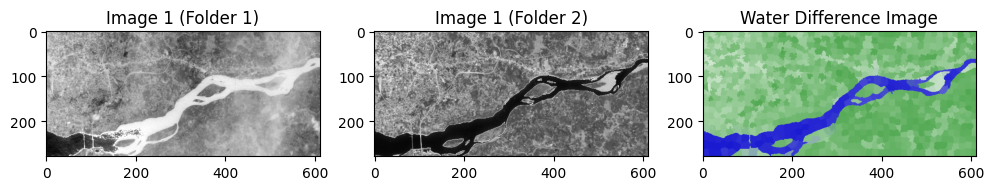

<ipython-input-1-55b3394bb06b>:87: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-1-55b3394bb06b>:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


Rate of Water Difference: 0.00%


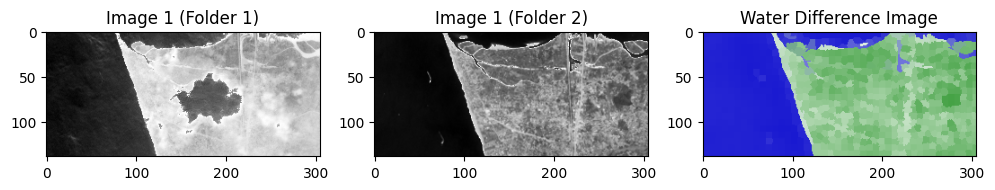

In [ ]:
import cv2
import numpy as np
from skimage import segmentation, color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 1)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA)
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Visualize the NDWI images
    plt.figure(figsize=(12, 6))
    plt.subplot(121), plt.imshow(image1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
    plt.subplot(122), plt.imshow(image2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
    plt.show()

    # Threshold on NDWI values directly
    water_mask = np.zeros_like(image1, dtype=np.uint8)
    water_mask[image1 >= ndwi_threshold] = 1  # Set water regions to 1

    # Highlight water changes in blue
    water_highlighted = image2.copy()
    water_highlighted[water_mask == 1] = [0, 0, 255]  # Highlight water changes in blue

    # Calculate and print the rate of difference for water
    water_difference_rate = calculate_water_difference_rate(water_mask[:, :, 0])  # Considering only the first channel
    print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    # Display the images
    plt.figure(figsize=(12, 6))
    plt.subplot(131), plt.imshow(image1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
    plt.subplot(132), plt.imshow(image2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
    plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
    plt.show()

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)

# Compare the second image from each folder
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)


<ipython-input-10-2d7463987187>:67: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-10-2d7463987187>:68: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


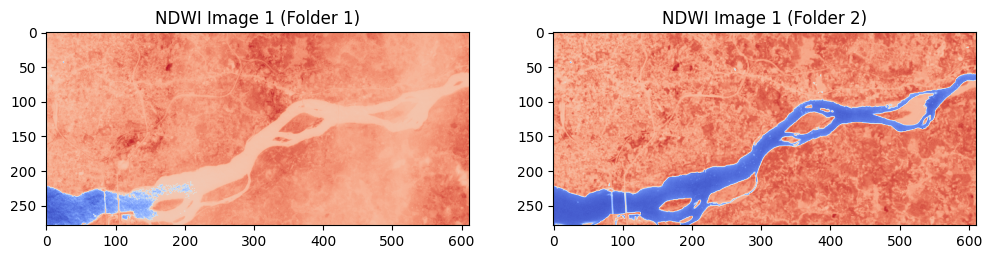

Rate of Water Difference: 23.69%


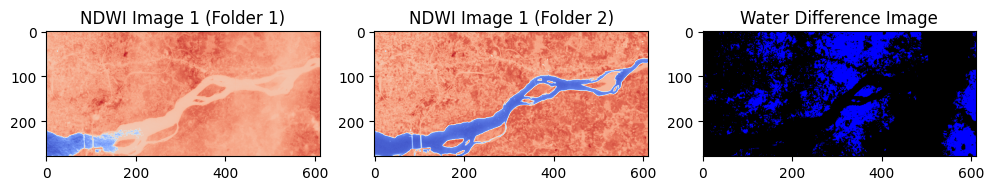

<ipython-input-10-2d7463987187>:74: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-10-2d7463987187>:75: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


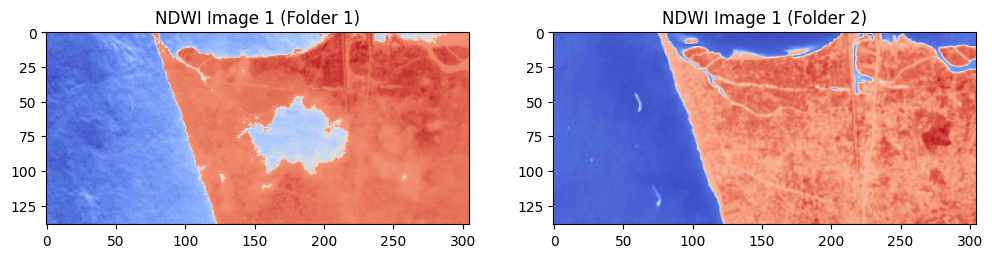

Rate of Water Difference: 1.89%


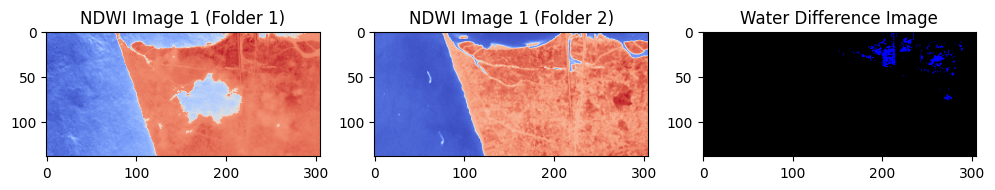

In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Calculate NDWI
        ndwi1 = (image1[:, :, 1].astype(float) - image1[:, :, 2]) / (image1[:, :, 1] + image1[:, :, 2])
        ndwi2 = (image2[:, :, 1].astype(float) - image2[:, :, 2]) / (image2[:, :, 1] + image2[:, :, 2])

        # Visualize the NDWI images using the 'coolwarm' colormap
        plt.figure(figsize=(12, 6))
        plt.subplot(121), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(122), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.show()

        # Threshold on NDWI values directly
        water_mask = np.zeros_like(ndwi1, dtype=np.uint8)
        water_mask[ndwi1 >= ndwi_threshold] = 255  # Set water regions to 255

        # Highlight water changes in blue
        water_highlighted = np.zeros_like(image2)
        water_highlighted[:, :, 2] = water_mask  # Set the blue channel based on the water mask

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_mask)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        # Display the images
        plt.figure(figsize=(12, 6))
        plt.subplot(131), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(132), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()
    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)


<ipython-input-11-2d7463987187>:67: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-11-2d7463987187>:68: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


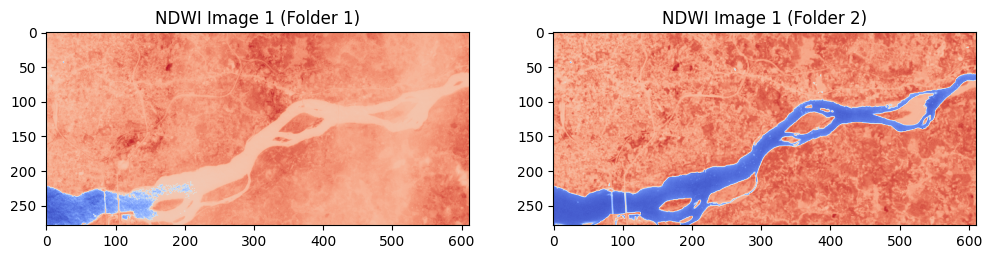

Rate of Water Difference: 23.69%


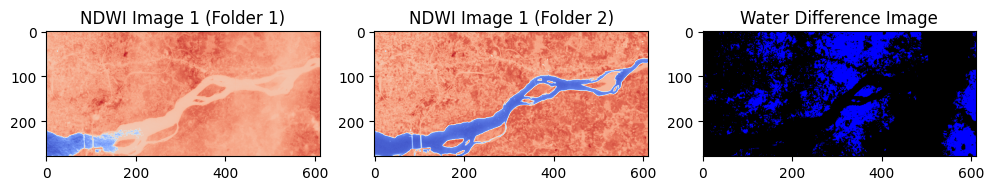

<ipython-input-11-2d7463987187>:74: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-11-2d7463987187>:75: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


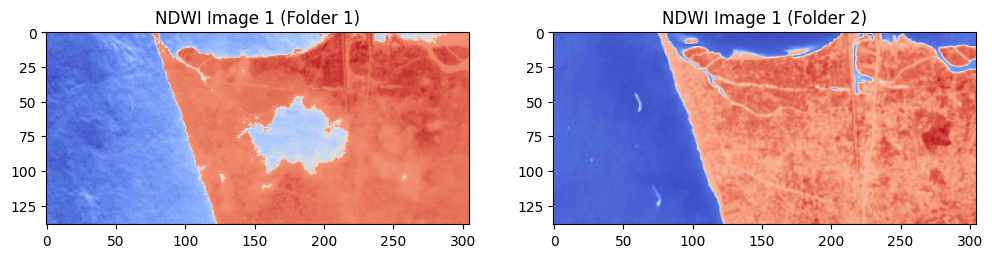

Rate of Water Difference: 1.89%


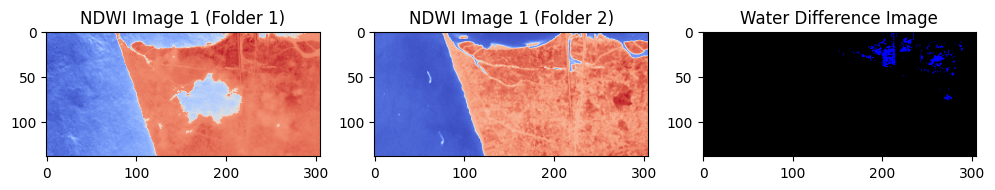

In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Calculate NDWI
        ndwi1 = (image1[:, :, 1].astype(float) - image1[:, :, 2]) / (image1[:, :, 1] + image1[:, :, 2])
        ndwi2 = (image2[:, :, 1].astype(float) - image2[:, :, 2]) / (image2[:, :, 1] + image2[:, :, 2])

        # Visualize the NDWI images using the 'coolwarm' colormap
        plt.figure(figsize=(12, 6))
        plt.subplot(121), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(122), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.show()

        # Threshold on NDWI values directly
        water_mask = np.zeros_like(ndwi1, dtype=np.uint8)
        water_mask[ndwi1 >= ndwi_threshold] = 255  # Set water regions to 255

        # Highlight water changes in blue
        water_highlighted = np.zeros_like(image2)
        water_highlighted[:, :, 2] = water_mask  # Set the blue channel based on the water mask

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_mask)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        # Display the images
        plt.figure(figsize=(12, 6))
        plt.subplot(131), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(132), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()
    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)


<ipython-input-12-d6c4a648409f>:71: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-12-d6c4a648409f>:72: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


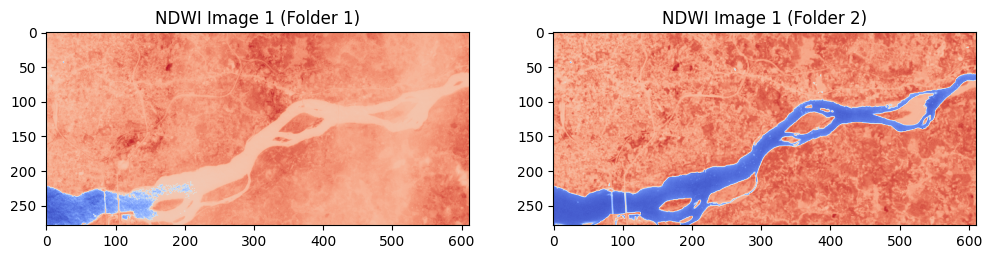

Rate of Water Difference: 57.14%


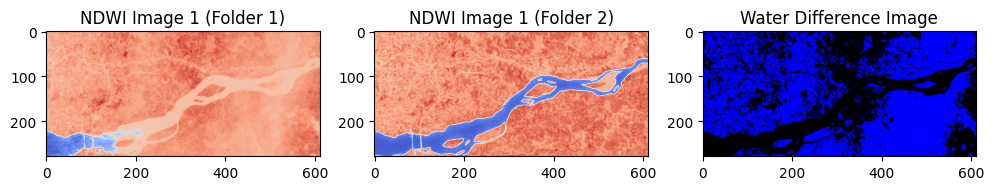

<ipython-input-12-d6c4a648409f>:78: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-12-d6c4a648409f>:79: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


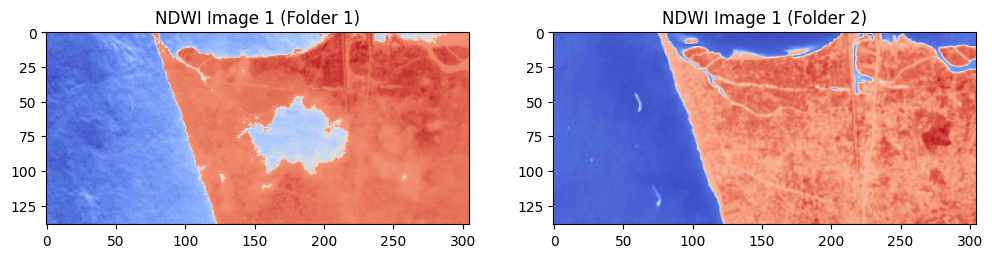

Rate of Water Difference: 51.69%


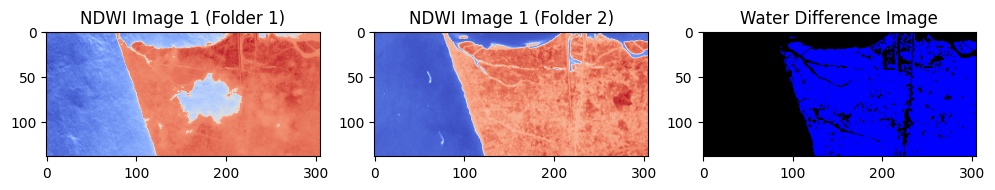

In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Calculate NDWI
        ndwi1 = (image1[:, :, 1].astype(float) - image1[:, :, 2]) / (image1[:, :, 1] + image1[:, :, 2])
        ndwi2 = (image2[:, :, 1].astype(float) - image2[:, :, 2]) / (image2[:, :, 1] + image2[:, :, 2])

        # Visualize the NDWI images using the 'coolwarm' colormap
        plt.figure(figsize=(12, 6))
        plt.subplot(121), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(122), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.show()

        # Threshold on NDWI values directly
        water_mask1 = np.zeros_like(ndwi1, dtype=np.uint8)
        water_mask1[ndwi1 >= ndwi_threshold] = 255  # Set water regions to 255

        water_mask2 = np.zeros_like(ndwi2, dtype=np.uint8)
        water_mask2[ndwi2 >= ndwi_threshold] = 255  # Set water regions to 255

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        # Display the images
        plt.figure(figsize=(12, 6))
        plt.subplot(131), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(132), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()
    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)


<ipython-input-13-d4580f38a9c9>:79: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-13-d4580f38a9c9>:80: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


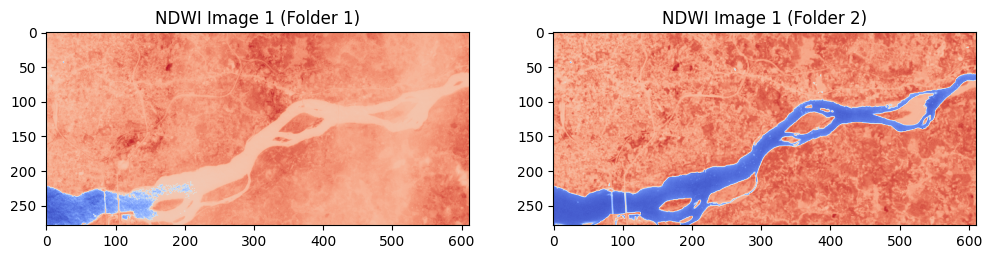

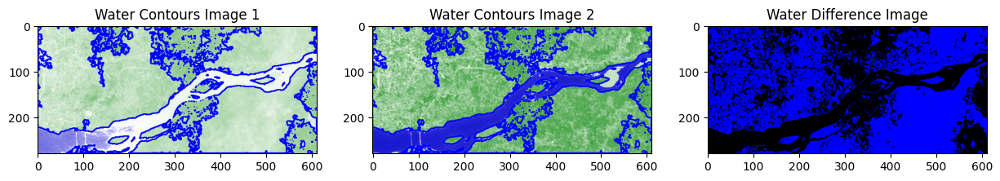

Rate of Water Difference: 57.14%


<ipython-input-13-d4580f38a9c9>:86: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-13-d4580f38a9c9>:87: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


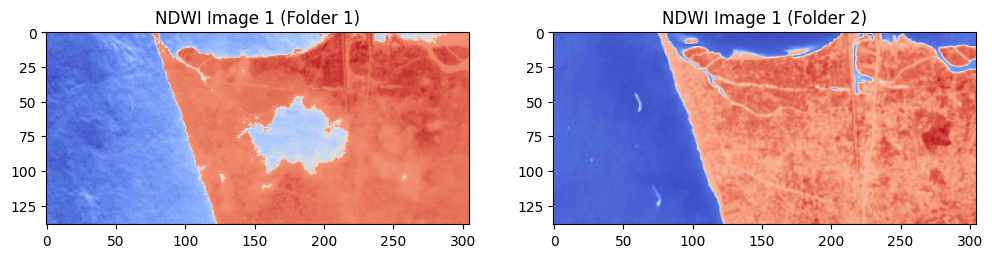

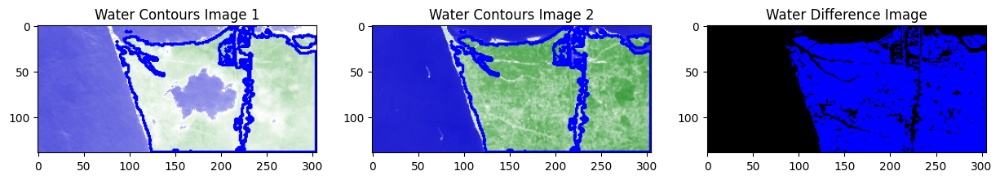

Rate of Water Difference: 51.69%


In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Calculate NDWI
        ndwi1 = (image1[:, :, 1].astype(float) - image1[:, :, 2]) / (image1[:, :, 1] + image1[:, :, 2])
        ndwi2 = (image2[:, :, 1].astype(float) - image2[:, :, 2]) / (image2[:, :, 1] + image2[:, :, 2])

        # Visualize the NDWI images using the 'coolwarm' colormap
        plt.figure(figsize=(12, 6))
        plt.subplot(121), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(122), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.show()

        # Threshold on NDWI values directly
        water_mask1 = np.zeros_like(ndwi1, dtype=np.uint8)
        water_mask1[ndwi1 >= ndwi_threshold] = 255  # Set water regions to 255

        water_mask2 = np.zeros_like(ndwi2, dtype=np.uint8)
        water_mask2[ndwi2 >= ndwi_threshold] = 255  # Set water regions to 255

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)


<ipython-input-14-bf7e4674658b>:78: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-14-bf7e4674658b>:79: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


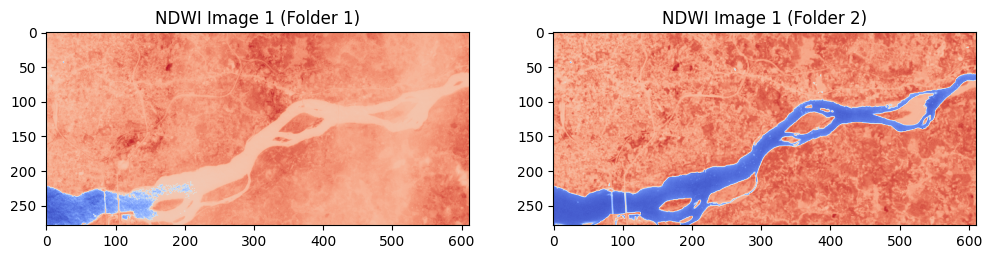

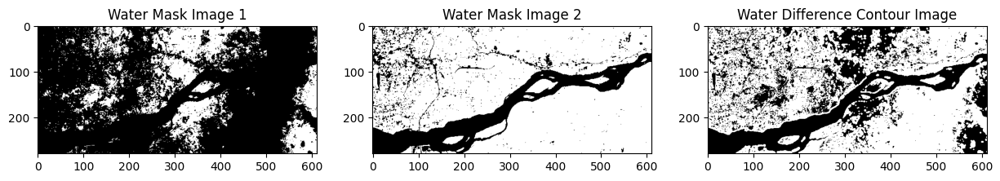

Rate of Water Difference: 57.14%


<ipython-input-14-bf7e4674658b>:85: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-14-bf7e4674658b>:86: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


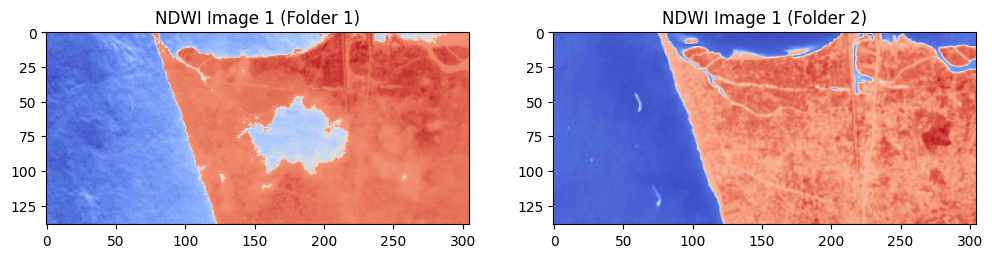

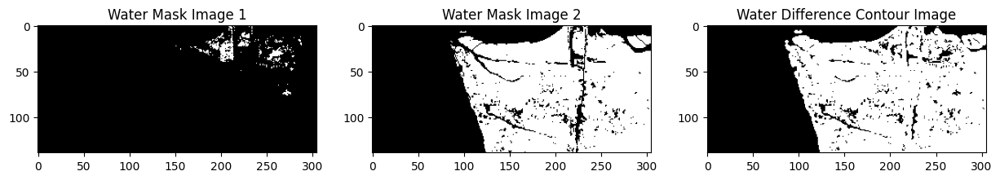

Rate of Water Difference: 51.69%


In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Calculate NDWI
        ndwi1 = (image1[:, :, 1].astype(float) - image1[:, :, 2]) / (image1[:, :, 1] + image1[:, :, 2])
        ndwi2 = (image2[:, :, 1].astype(float) - image2[:, :, 2]) / (image2[:, :, 1] + image2[:, :, 2])

        # Visualize the NDWI images using the 'coolwarm' colormap
        plt.figure(figsize=(12, 6))
        plt.subplot(121), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(122), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.show()

        # Threshold on NDWI values directly
        water_mask1 = np.zeros_like(ndwi1, dtype=np.uint8)
        water_mask1[ndwi1 >= ndwi_threshold] = 255  # Set water regions to 255

        water_mask2 = np.zeros_like(ndwi2, dtype=np.uint8)
        water_mask2[ndwi2 >= ndwi_threshold] = 255  # Set water regions to 255

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the water difference image
        water_difference_contour = cv2.drawContours(water_difference.copy(), contours, -1, 255, 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_mask1, cmap='gray'), plt.title('Water Mask Image 1')
        plt.subplot(132), plt.imshow(water_mask2, cmap='gray'), plt.title('Water Mask Image 2')
        plt.subplot(133), plt.imshow(water_difference_contour, cmap='gray'), plt.title('Water Difference Contour Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)


<ipython-input-15-5bcd35443087>:77: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-15-5bcd35443087>:78: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


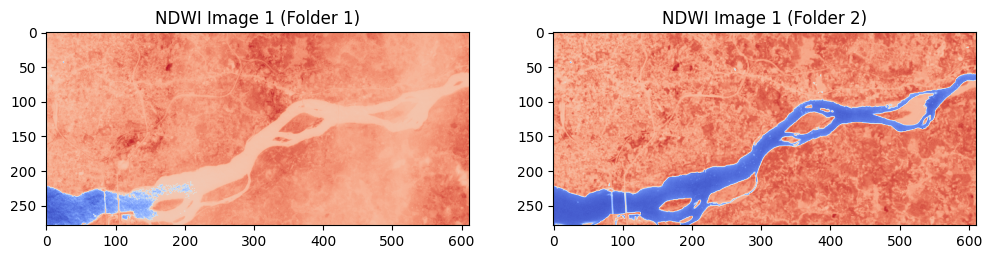

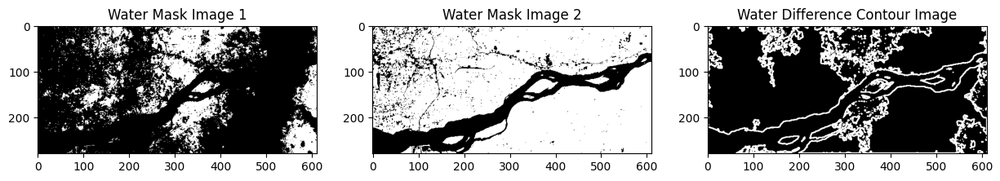

Rate of Water Difference: 57.14%


<ipython-input-15-5bcd35443087>:84: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-15-5bcd35443087>:85: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


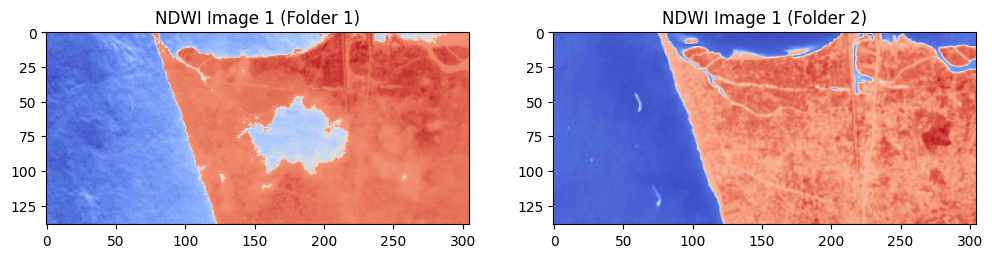

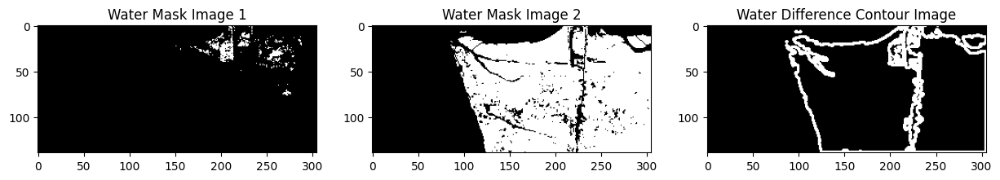

Rate of Water Difference: 51.69%


In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Calculate NDWI
        ndwi1 = (image1[:, :, 1].astype(float) - image1[:, :, 2]) / (image1[:, :, 1] + image1[:, :, 2])
        ndwi2 = (image2[:, :, 1].astype(float) - image2[:, :, 2]) / (image2[:, :, 1] + image2[:, :, 2])

        # Visualize the NDWI images using the 'coolwarm' colormap
        plt.figure(figsize=(12, 6))
        plt.subplot(121), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(122), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.show()

        # Threshold on NDWI values directly
        water_mask1 = np.zeros_like(ndwi1, dtype=np.uint8)
        water_mask1[ndwi1 >= ndwi_threshold] = 255  # Set water regions to 255

        water_mask2 = np.zeros_like(ndwi2, dtype=np.uint8)
        water_mask2[ndwi2 >= ndwi_threshold] = 255  # Set water regions to 255

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the water difference image
        water_difference_contour = np.zeros_like(water_difference)
        cv2.drawContours(water_difference_contour, contours, -1, 255, 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_mask1, cmap='gray'), plt.title('Water Mask Image 1')
        plt.subplot(132), plt.imshow(water_mask2, cmap='gray'), plt.title('Water Mask Image 2')
        plt.subplot(133), plt.imshow(water_difference_contour, cmap='gray'), plt.title('Water Difference Contour Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)


<ipython-input-16-57750e2ee895>:74: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-16-57750e2ee895>:75: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


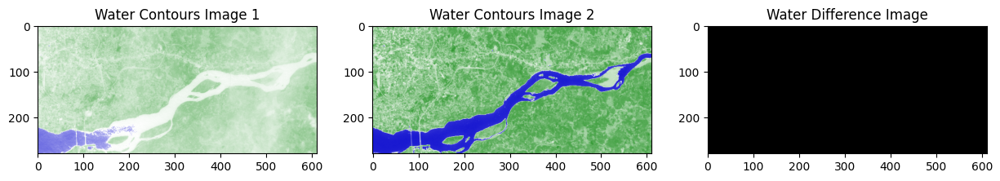

Rate of Water Difference: 0.00%


<ipython-input-16-57750e2ee895>:81: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-16-57750e2ee895>:82: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


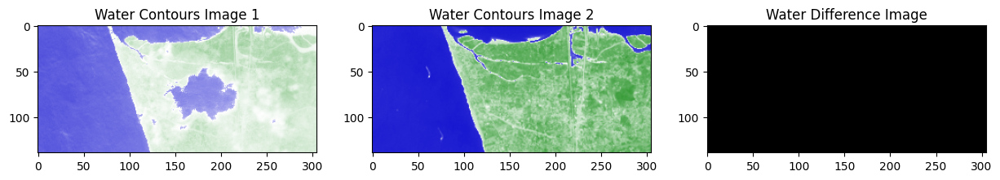

Rate of Water Difference: 0.00%


In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Define lower and upper bounds for blue color
        lower_blue = np.array([0, 0, 100], dtype=np.uint8)
        upper_blue = np.array([140, 255, 255], dtype=np.uint8)

        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_BGR2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_BGR2HSV)

        # Create a blue mask for each image
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(blue_mask1, blue_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)


<ipython-input-17-7b52f854936d>:73: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-17-7b52f854936d>:74: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


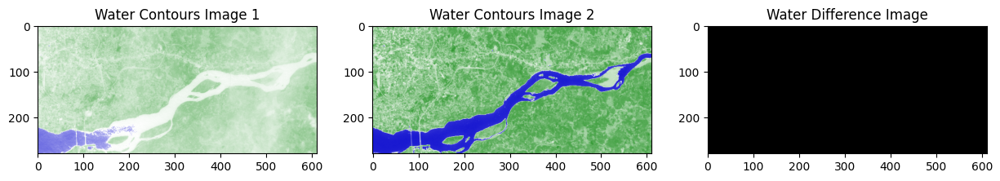

Rate of Water Difference: 0.00%


<ipython-input-17-7b52f854936d>:80: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-17-7b52f854936d>:81: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


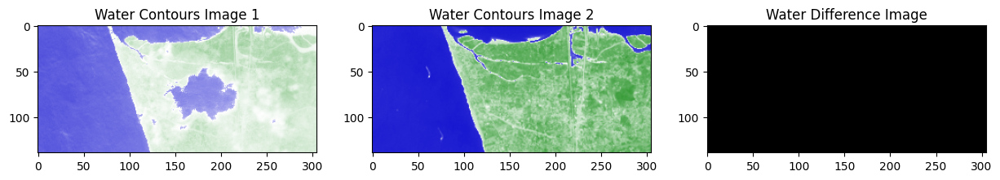

Rate of Water Difference: 0.00%


In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Extract blue channel
        blue_channel1 = image1[:, :, 0]
        blue_channel2 = image2[:, :, 0]

        # Threshold on blue channel values directly
        water_mask1 = np.zeros_like(blue_channel1, dtype=np.uint8)
        water_mask1[blue_channel1 >= ndwi_threshold] = 255  # Set water regions to 255

        water_mask2 = np.zeros_like(blue_channel2, dtype=np.uint8)
        water_mask2[blue_channel2 >= ndwi_threshold] = 255  # Set water regions to 255

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=100)  # Adjust threshold if needed

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=100)  # Adjust threshold if needed


<ipython-input-18-b1787bf1f5d8>:70: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-18-b1787bf1f5d8>:71: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


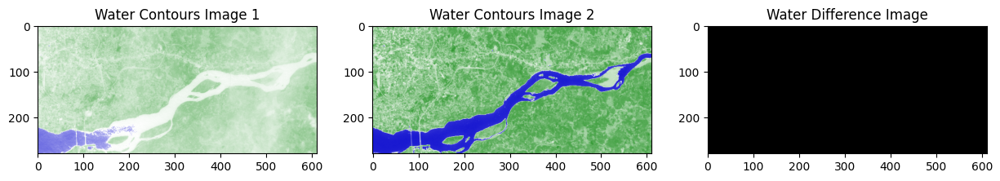

Rate of Water Difference: 0.00%


<ipython-input-18-b1787bf1f5d8>:77: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-18-b1787bf1f5d8>:78: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


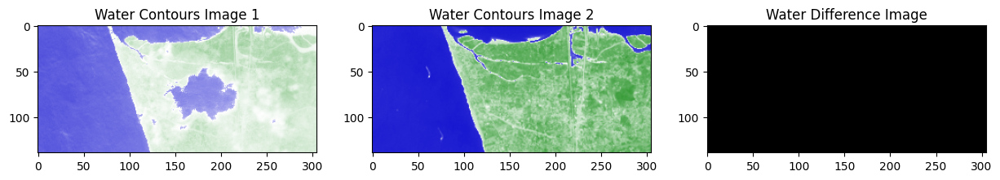

Rate of Water Difference: 0.00%


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import imageio

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using blue channel
def obia(image1, image2, ndwi_threshold=100):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Extract blue channel
        blue_channel1 = image1[:, :, 0]
        blue_channel2 = image2[:, :, 0]

        # Threshold on blue channel values directly
        water_mask1 = np.zeros_like(blue_channel1, dtype=np.uint8)
        water_mask1[blue_channel1 >= ndwi_threshold] = 255  # Set water regions to 255

        water_mask2 = np.zeros_like(blue_channel2, dtype=np.uint8)
        water_mask2[blue_channel2 >= ndwi_threshold] = 255  # Set water regions to 255

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_difference, cmap='gray'), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=100)  # Adjust threshold if needed

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=100)  # Adjust threshold if needed


<ipython-input-19-d4580f38a9c9>:79: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-19-d4580f38a9c9>:80: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


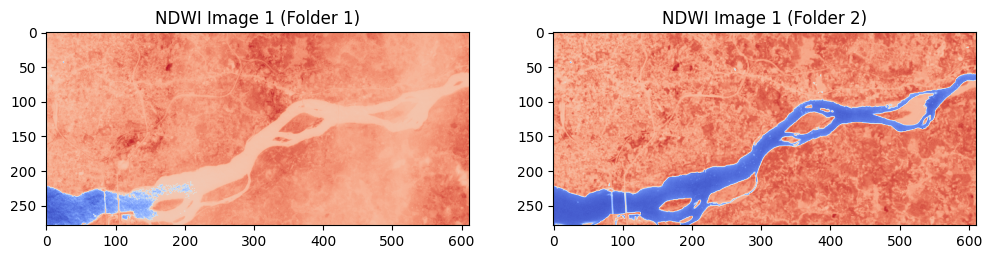

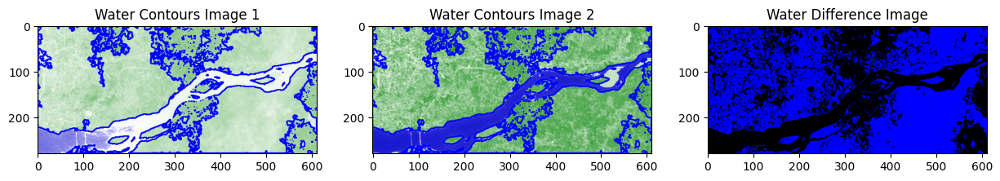

Rate of Water Difference: 57.14%


<ipython-input-19-d4580f38a9c9>:86: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-19-d4580f38a9c9>:87: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


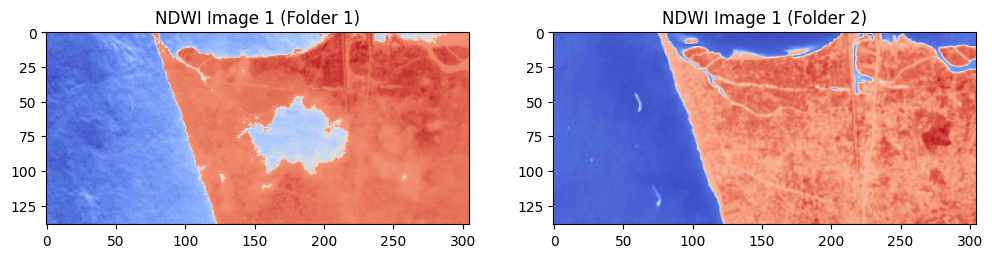

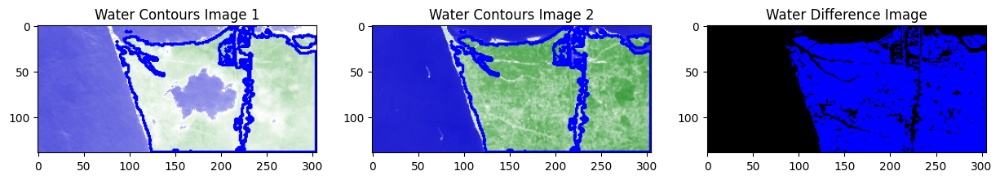

Rate of Water Difference: 51.69%


In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.1):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Calculate NDWI
        ndwi1 = (image1[:, :, 1].astype(float) - image1[:, :, 2]) / (image1[:, :, 1] + image1[:, :, 2])
        ndwi2 = (image2[:, :, 1].astype(float) - image2[:, :, 2]) / (image2[:, :, 1] + image2[:, :, 2])

        # Visualize the NDWI images using the 'coolwarm' colormap
        plt.figure(figsize=(12, 6))
        plt.subplot(121), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(122), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.show()

        # Threshold on NDWI values directly
        water_mask1 = np.zeros_like(ndwi1, dtype=np.uint8)
        water_mask1[ndwi1 >= ndwi_threshold] = 255  # Set water regions to 255

        water_mask2 = np.zeros_like(ndwi2, dtype=np.uint8)
        water_mask2[ndwi2 >= ndwi_threshold] = 255  # Set water regions to 255

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.1)


<ipython-input-24-27c6fa8f992e>:84: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-24-27c6fa8f992e>:85: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


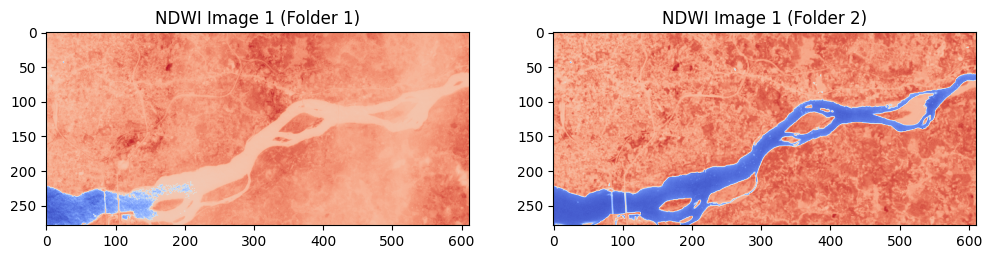

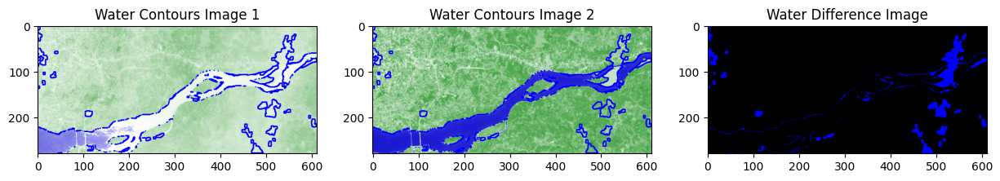

Rate of Water Difference: 4.97%


<ipython-input-24-27c6fa8f992e>:91: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-24-27c6fa8f992e>:92: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


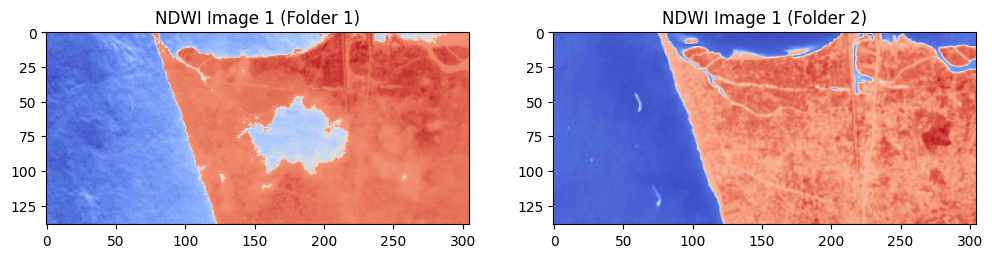

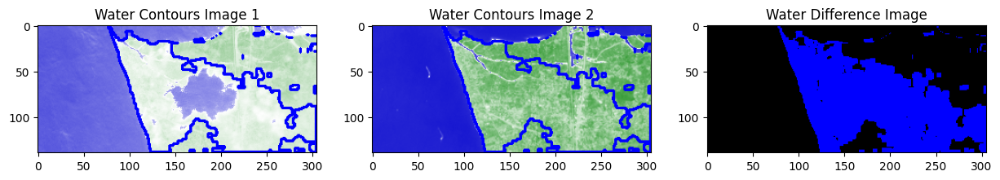

Rate of Water Difference: 39.09%


In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio  # Import the imageio library for TIFF support

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.05):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Calculate NDWI
        ndwi1 = (image1[:, :, 1].astype(float) - image1[:, :, 2]) / (image1[:, :, 1] + image1[:, :, 2])
        ndwi2 = (image2[:, :, 1].astype(float) - image2[:, :, 2]) / (image2[:, :, 1] + image2[:, :, 2])

        # Visualize the NDWI images using the 'coolwarm' colormap
        plt.figure(figsize=(12, 6))
        plt.subplot(121), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(122), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.show()

        # Threshold on NDWI values directly
        water_mask1 = np.zeros_like(ndwi1, dtype=np.uint8)
        water_mask1[ndwi1 >= ndwi_threshold] = 255  # Set water regions to 255

        water_mask2 = np.zeros_like(ndwi2, dtype=np.uint8)
        water_mask2[ndwi2 >= ndwi_threshold] = 255  # Set water regions to 255

        # Perform morphological operations for refinement
        kernel = np.ones((5, 5), np.uint8)
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.05)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.05)


<ipython-input-25-7da7e506d779>:84: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-25-7da7e506d779>:85: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


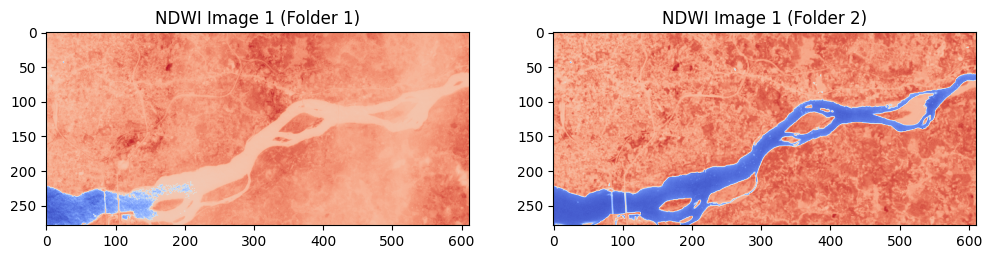

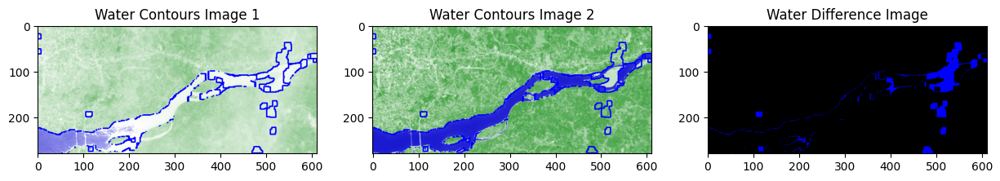

Rate of Water Difference: 4.17%


<ipython-input-25-7da7e506d779>:91: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-25-7da7e506d779>:92: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


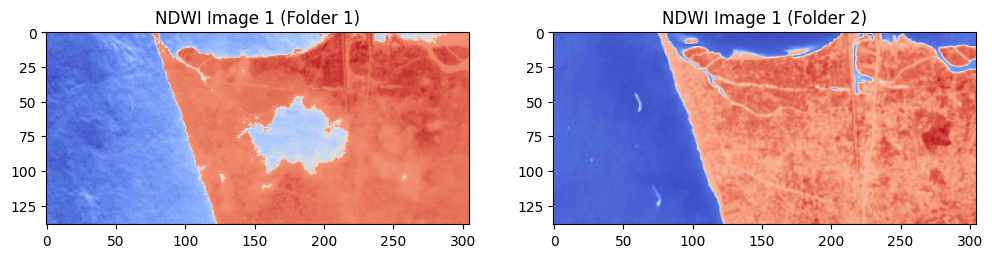

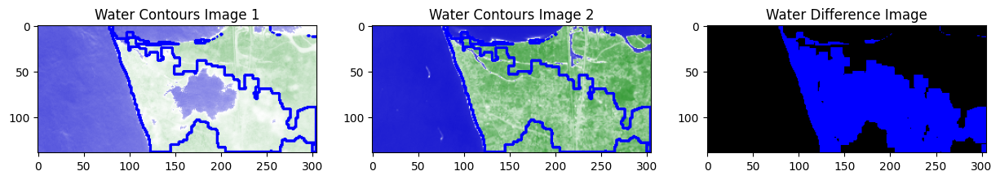

Rate of Water Difference: 36.27%


In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.05):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Calculate NDWI
        ndwi1 = (image1[:, :, 1].astype(float) - image1[:, :, 2]) / (image1[:, :, 1] + image1[:, :, 2])
        ndwi2 = (image2[:, :, 1].astype(float) - image2[:, :, 2]) / (image2[:, :, 1] + image2[:, :, 2])

        # Visualize the NDWI images using the 'coolwarm' colormap
        plt.figure(figsize=(12, 6))
        plt.subplot(121), plt.imshow(ndwi1, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 1)')
        plt.subplot(122), plt.imshow(ndwi2, cmap='coolwarm'), plt.title('NDWI Image 1 (Folder 2)')
        plt.show()

        # Threshold on NDWI values directly
        water_mask1 = np.zeros_like(ndwi1, dtype=np.uint8)
        water_mask1[ndwi1 >= ndwi_threshold] = 255  # Set water regions to 255

        water_mask2 = np.zeros_like(ndwi2, dtype=np.uint8)
        water_mask2[ndwi2 >= ndwi_threshold] = 255  # Set water regions to 255

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.05)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.05)


<ipython-input-26-d52288bf7e7a>:87: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-26-d52288bf7e7a>:88: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


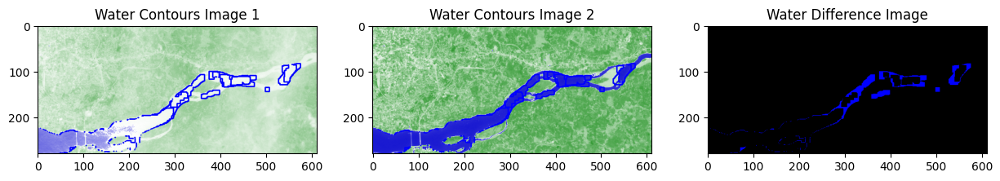

Rate of Water Difference: 2.47%


<ipython-input-26-d52288bf7e7a>:94: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-26-d52288bf7e7a>:95: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


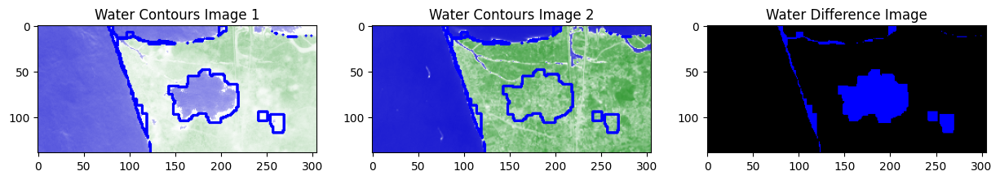

Rate of Water Difference: 10.32%


In [ ]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.02)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.02)


<ipython-input-1-26a29471a931>:99: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-1-26a29471a931>:100: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


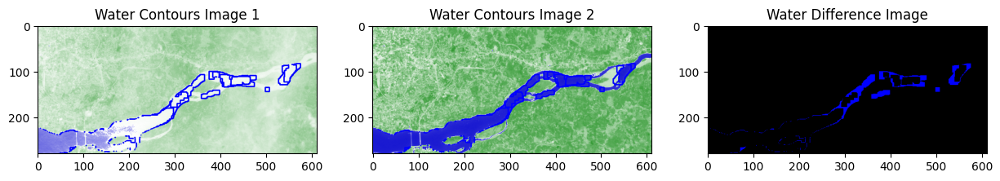

Rate of Water Difference: 2.47%


<ipython-input-1-26a29471a931>:106: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-1-26a29471a931>:107: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


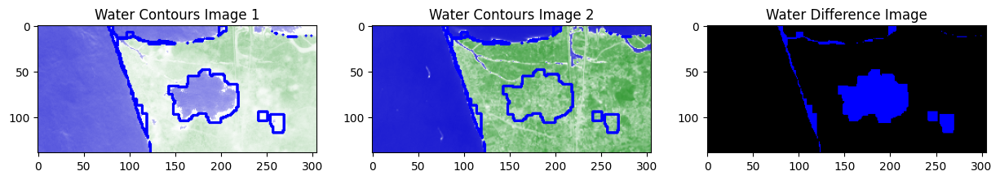

Rate of Water Difference: 10.32%


In [1]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            cv2.imwrite(os.path.join(save_path, 'water_highlighted_1.jpg'), cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(os.path.join(save_path, 'water_highlighted_2.jpg'), cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(os.path.join(save_path, 'water_difference.jpg'), cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# Specify the path to save the water-highlighted images
save_path = "/content/drive/MyDrive/WaterHighlightedImages"

# Create the directory if it does not exist
os.makedirs(save_path, exist_ok=True)

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Compare the first image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[0])
image2_path = os.path.join(folder_path2, image_files2[0])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.02, save_path=save_path)

# Compare the second image from each folder with a different NDWI threshold
image1_path = os.path.join(folder_path1, image_files1[1])
image2_path = os.path.join(folder_path2, image_files2[1])
img1 = imageio.imread(image1_path)
img2 = imageio.imread(image2_path)
obia(img1, img2, ndwi_threshold=0.02, save_path=save_path)


In [5]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers, models

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the path to the folder containing water-highlighted images
folder_path = "/content/drive/MyDrive/Folder1"  # Update with your folder path

# Load and preprocess data
images, labels = load_and_preprocess_data(folder_path)

# Split data into training and testing sets (considering a single image for testing)
X_train, X_test, y_train, y_test = images, images[0:1], labels, labels[0:1]

# Check if data is not empty before training
if len(X_train) > 0 and len(y_train) > 0:
    # Define CNN model
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # Binary classification output
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Train the model
    model.fit(X_train, y_train, epochs=10)

    # Evaluate the model
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Save the model for future use
    model.save("/content/drive/MyDrive/water_change_detection_model.h5")
else:
    print("Data is empty. Please check your dataset.")


Data is empty. Please check your dataset.


<ipython-input-1-e4f09cff98f2>:108: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-1-e4f09cff98f2>:109: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


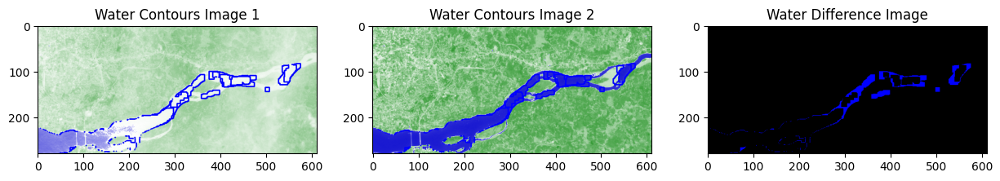

Rate of Water Difference: 2.47%


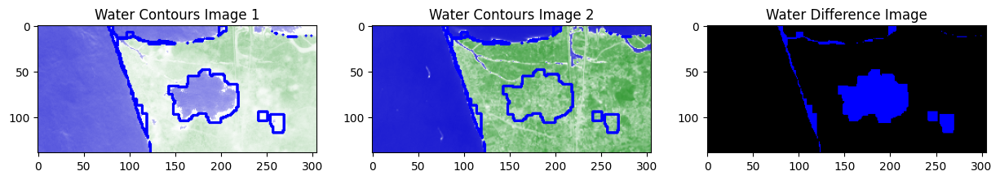

Rate of Water Difference: 10.32%


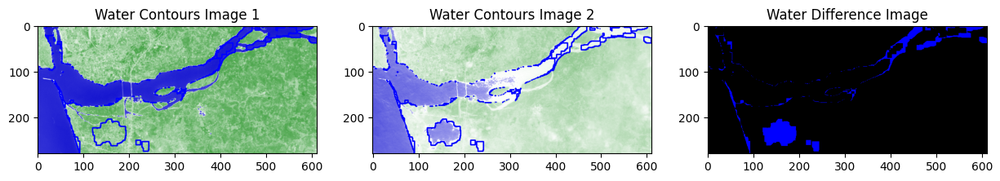

Rate of Water Difference: 5.02%


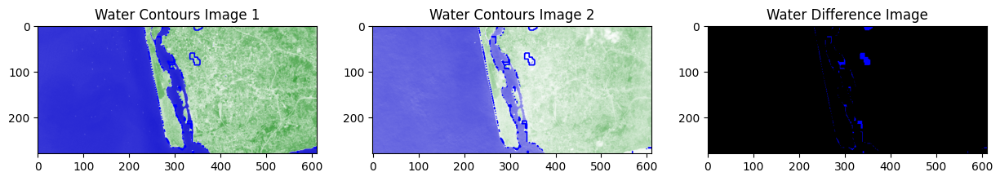

Rate of Water Difference: 0.79%


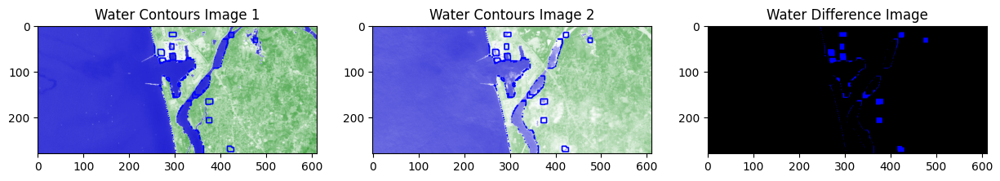

Rate of Water Difference: 1.47%


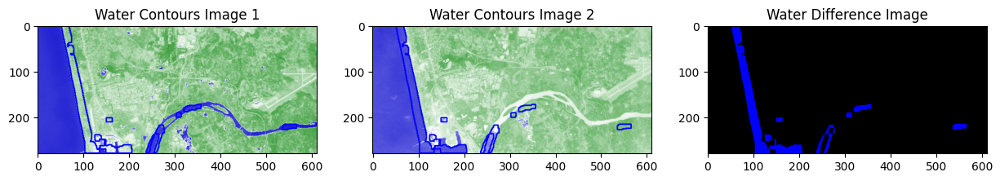

Rate of Water Difference: 4.91%


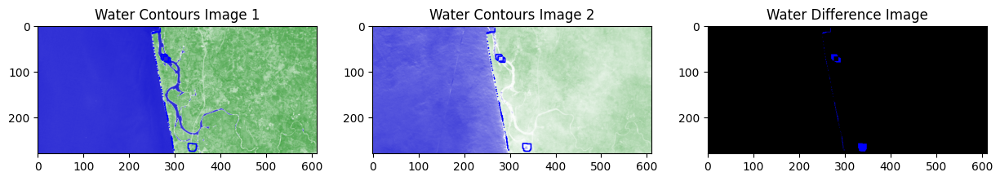

Rate of Water Difference: 0.41%


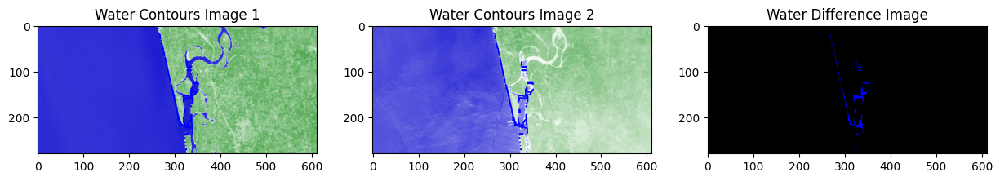

Rate of Water Difference: 0.56%


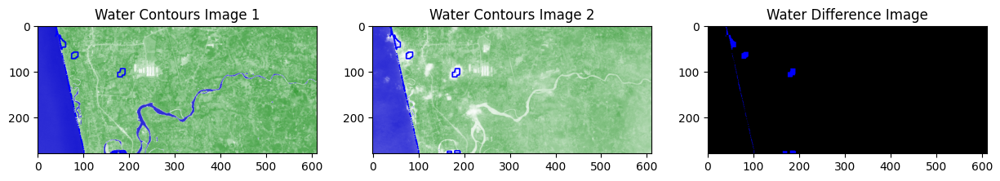

Rate of Water Difference: 0.62%


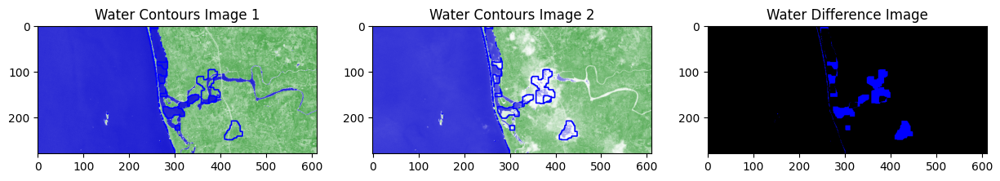

Rate of Water Difference: 3.45%


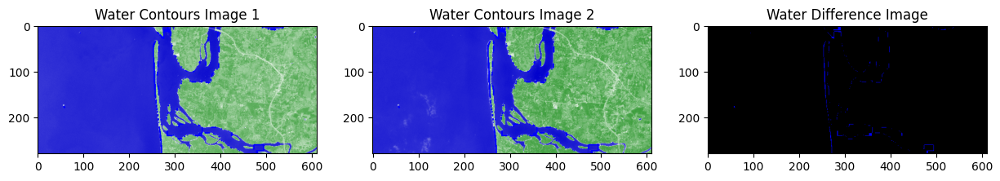

Rate of Water Difference: 0.56%


In [1]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            filename1 = os.path.join(save_path, f'water_highlighted_1_{os.path.basename(image1_path)}')
            filename2 = os.path.join(save_path, f'water_highlighted_2_{os.path.basename(image2_path)}')
            filename_diff = os.path.join(save_path, f'water_difference_{os.path.basename(image1_path)}_{os.path.basename(image2_path)}')

            cv2.imwrite(filename1, cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename2, cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename_diff, cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# Specify the path to save the water-highlighted images
save_path = "/content/drive/MyDrive/WaterHighlightedImages"

# Create the directory if it does not exist
os.makedirs(save_path, exist_ok=True)

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Iterate over pairs of images from the two folders
for i in range(min(len(image_files1), len(image_files2))):
    image_file1 = image_files1[i]
    image_file2 = image_files2[i]

    image1_path = os.path.join(folder_path1, image_file1)
    image2_path = os.path.join(folder_path2, image_file2)

    img1 = imageio.imread(image1_path)
    img2 = imageio.imread(image2_path)

    obia(img1, img2, ndwi_threshold=0.02, save_path=save_path)


In [3]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers, models

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the path to the folder containing water-highlighted images
folder_path = "/content/drive/MyDrive/Folder1"  # Update with your folder path

# Load and preprocess data
images, labels = load_and_preprocess_data(folder_path)

# Print the number of loaded images
print(f"Number of loaded images: {len(images)}")

# Split data into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Check if data is not empty before training
if len(X_train) > 0 and len(y_train) > 0:
    # Define CNN model
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # Binary classification output
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Train the model
    model.fit(X_train, y_train, epochs=10, validation_split=0.2)  # Using a validation split during training

    # Evaluate the model
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Save the model for future use
    model.save("/content/drive/MyDrive/water_change_detection_model.h5")
else:
    print("Data is empty. Please check your dataset.")


Number of loaded images: 0


ValueError: With n_samples=0, test_size=0.2 and train_size=None, the resulting train set will be empty. Adjust any of the aforementioned parameters.

In [7]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            filename1 = os.path.join(save_path, f'water_highlighted_1_{os.path.basename(image1_path)}')
            filename2 = os.path.join(save_path, f'water_highlighted_2_{os.path.basename(image2_path)}')
            filename_diff = os.path.join(save_path, f'water_difference_{os.path.basename(image1_path)}_{os.path.basename(image2_path)}')

            cv2.imwrite(filename1, cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename2, cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename_diff, cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        return water_difference_rate

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the path to the folder containing water-highlighted images
folder_path = "/content/drive/MyDrive/WaterHighlightedImages"  # Update with your folder path

# Load and preprocess data
images, labels = load_and_preprocess_data(folder_path)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Check if data is not empty before training
if len(X_train) > 0 and len(y_train) > 0:
    # Define CNN model
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # Binary classification output
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Train the model
    model.fit(X_train, y_train, epochs=10)

    # Evaluate the model
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Save the model for future use
    model.save("/content/drive/MyDrive/water_change_detection_model.h5")

    # Use the trained model for predictions
    for i in range(len(X_test)):
        cnn_image = cv2.resize(X_test[i], (224, 224))
        cnn_image = np.expand_dims(cnn_image, axis=0)  # Add batch dimension
        cnn_prediction = model.predict(cnn_image)
        print(f'CNN Prediction for Test Image {i + 1}: {cnn_prediction[0][0]}')

else:
    print("Data is empty. Please check your dataset.")


Epoch 1/10
1/1 [==============================] - 2s 2s/step - loss: 0.0752 - accuracy: 1.0000
Epoch 2/10
1/1 [==============================] - 0s 330ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 3/10
1/1 [==============================] - 0s 313ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 4/10
1/1 [==============================] - 0s 302ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 5/10
1/1 [==============================] - 0s 296ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 6/10
1/1 [==============================] - 0s 322ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 7/10
1/1 [==============================] - 0s 302ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 8/10
1/1 [==============================] - 0s 440ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 9/10
1/1 [==============================] - 0s 496ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 10/10
1/1 [==============================] - 0s 336ms/step - loss: 0.0000e+00 - acc

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 131ms/step
CNN Prediction for Test Image 1: 1.0


Epoch 1/10
1/1 [==============================] - 1s 1s/step - loss: 10.3595 - accuracy: 0.0000e+00
Epoch 2/10
1/1 [==============================] - 0s 306ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 3/10
1/1 [==============================] - 0s 302ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 4/10
1/1 [==============================] - 0s 314ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 5/10
1/1 [==============================] - 0s 398ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 6/10
1/1 [==============================] - 1s 501ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 7/10
1/1 [==============================] - 0s 498ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 8/10
1/1 [==============================] - 0s 441ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 9/10
1/1 [==============================] - 0s 463ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 10/10
1/1 [==============================] - 0s 174ms/step - loss: 0.0000e+00 

<ipython-input-8-e009074883f2>:68: RuntimeWarning: divide by zero encountered in divide
  return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])
<ipython-input-8-e009074883f2>:68: RuntimeWarning: invalid value encountered in divide
  return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])


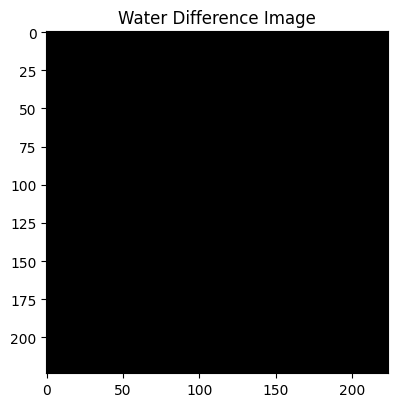

Rate of Water Difference: 0.00%


In [8]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        return water_difference_rate

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the path to the folder containing water-highlighted images
folder_path = "/content/drive/MyDrive/WaterHighlightedImages"  # Update with your folder path

# Load and preprocess data
images, labels = load_and_preprocess_data(folder_path)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Check if data is not empty before training
if len(X_train) > 0 and len(y_train) > 0:
    # Define CNN model
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # Binary classification output
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Train the model
    model.fit(X_train, y_train, epochs=10)

    # Evaluate the model
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Save the model for future use
    model.save("/content/drive/MyDrive/water_change_detection_model.h5")

    # Use the trained model for predictions
    for i in range(len(X_test)):
        cnn_image = cv2.resize(X_test[i], (224, 224))
        cnn_image = np.expand_dims(cnn_image, axis=0)  # Add batch dimension
        cnn_prediction = model.predict(cnn_image)
        print(f'CNN Prediction for Test Image {i + 1}: {cnn_prediction[0][0]}')

        # Display water-highlighted images
        water_difference_rate = obia(X_test[i], X_test[i-1], ndwi_threshold=0.02, save_path=None)

else:
    print("Data is empty. Please check your dataset.")


<ipython-input-9-cdceccfda304>:117: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-9-cdceccfda304>:118: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


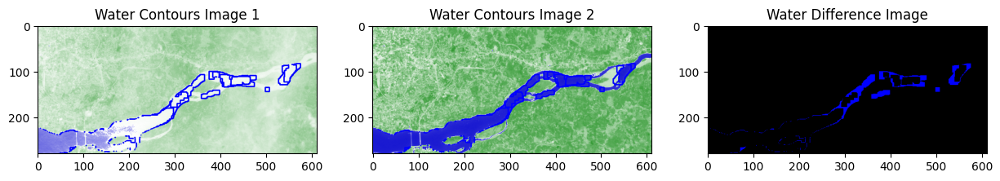

Rate of Water Difference: 2.47%
1/1 [==============================] - 0s 98ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 47ms/step


CNN Prediction for Image 2: 1.0


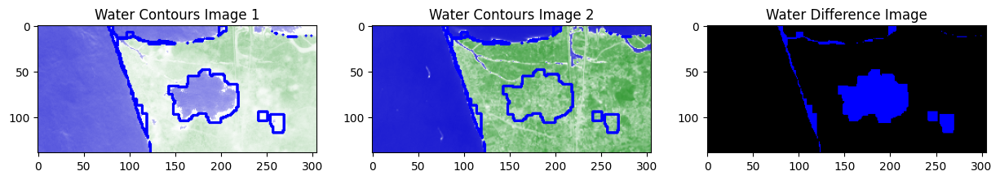

Rate of Water Difference: 10.32%
1/1 [==============================] - 0s 44ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 57ms/step
CNN Prediction for Image 2: 1.0


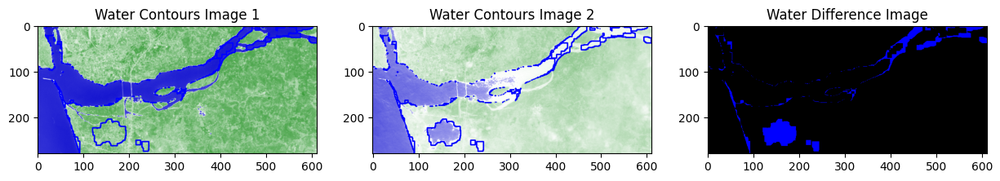

Rate of Water Difference: 5.02%
1/1 [==============================] - 0s 50ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 47ms/step
CNN Prediction for Image 2: 1.0


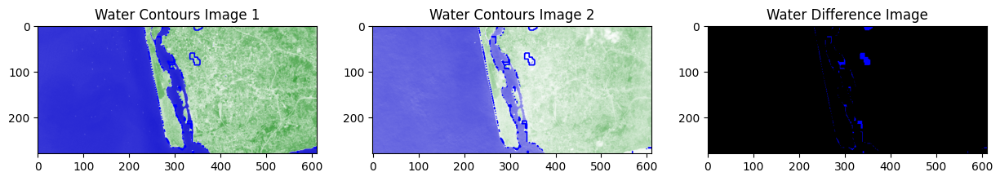

Rate of Water Difference: 0.79%
1/1 [==============================] - 0s 42ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 53ms/step
CNN Prediction for Image 2: 1.0


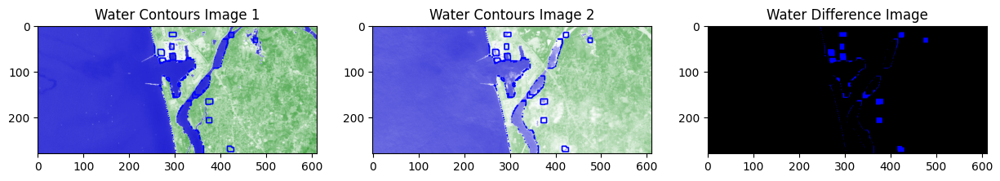

Rate of Water Difference: 1.47%
1/1 [==============================] - 0s 41ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 53ms/step
CNN Prediction for Image 2: 1.0


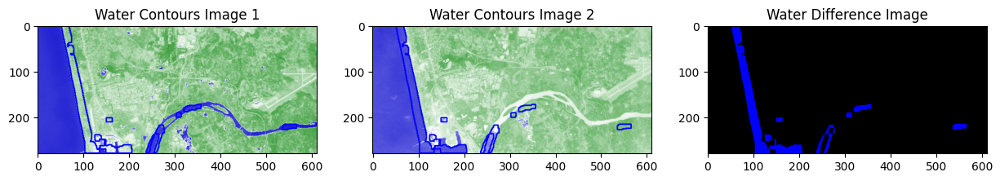

Rate of Water Difference: 4.91%
1/1 [==============================] - 0s 87ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 84ms/step


CNN Prediction for Image 2: 1.0


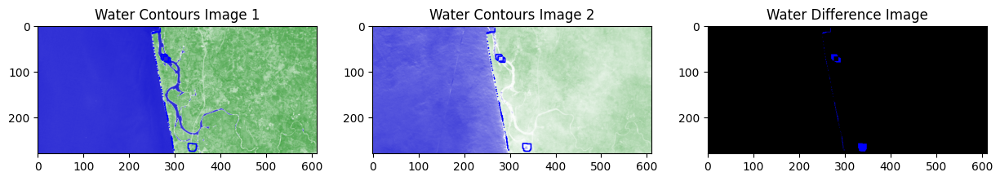

Rate of Water Difference: 0.41%
1/1 [==============================] - 0s 61ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 70ms/step
CNN Prediction for Image 2: 1.0


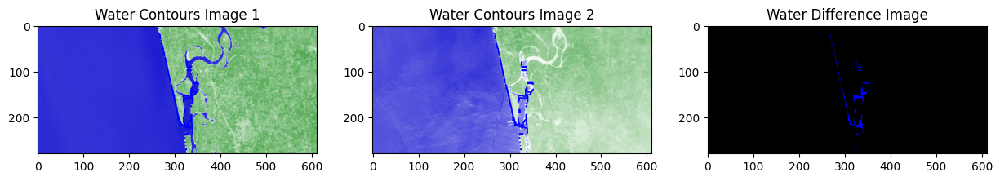

Rate of Water Difference: 0.56%
1/1 [==============================] - 0s 67ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 89ms/step
CNN Prediction for Image 2: 1.0


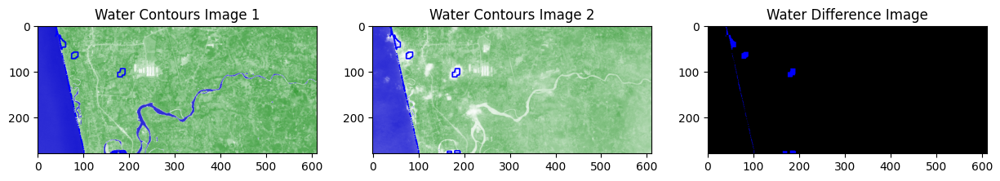

Rate of Water Difference: 0.62%
1/1 [==============================] - 0s 51ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 51ms/step
CNN Prediction for Image 2: 1.0


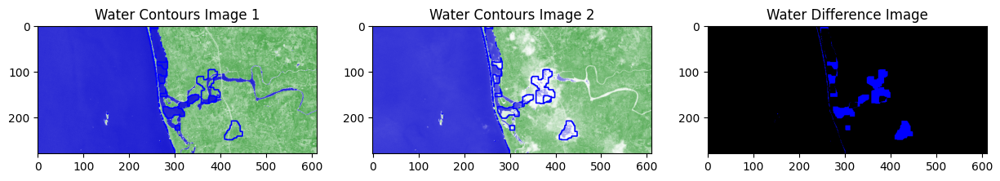

Rate of Water Difference: 3.45%
1/1 [==============================] - 0s 59ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 56ms/step
CNN Prediction for Image 2: 1.0


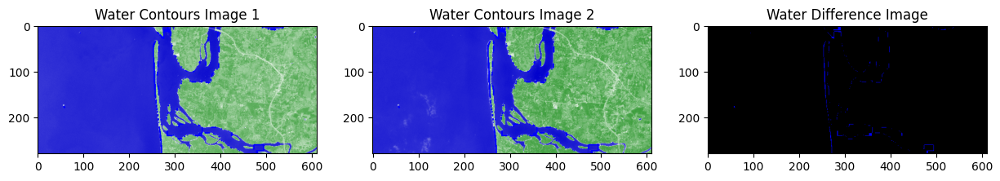

Rate of Water Difference: 0.56%
1/1 [==============================] - 0s 57ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 59ms/step
CNN Prediction for Image 2: 1.0


In [9]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers, models
from skimage import color
import imageio

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI and CNN
def obia_with_cnn(image1, image2, ndwi_threshold=0.02, save_path=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        # Use the trained CNN model for predictions
        cnn_image = cv2.resize(image1, (224, 224))
        cnn_image = np.expand_dims(cnn_image, axis=0)  # Add batch dimension
        cnn_prediction = model.predict(cnn_image)
        print(f'CNN Prediction for Image 1: {cnn_prediction[0][0]}')

        cnn_image = cv2.resize(image2, (224, 224))
        cnn_image = np.expand_dims(cnn_image, axis=0)  # Add batch dimension
        cnn_prediction = model.predict(cnn_image)
        print(f'CNN Prediction for Image 2: {cnn_prediction[0][0]}')

        return water_difference_rate

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Load the pre-trained CNN model
model_path = "/content/drive/MyDrive/water_change_detection_model.h5"
model = models.load_model(model_path)

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# Specify the path to save the water-highlighted images
save_path = "/content/drive/MyDrive/WaterHighlightedImages"

# Create the directory if it does not exist
os.makedirs(save_path, exist_ok=True)

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Iterate over pairs of images from the two folders
for i in range(min(len(image_files1), len(image_files2))):
    image_file1 = image_files1[i]
    image_file2 = image_files2[i]

    image1_path = os.path.join(folder_path1, image_file1)
    image2_path = os.path.join(folder_path2, image_file2)

    img1 = imageio.imread(image1_path)
    img2 = imageio.imread(image2_path)

    obia_with_cnn(img1, img2, ndwi_threshold=0.02, save_path=save_path)


Epoch 1/10
1/1 [==============================] - 2s 2s/step - loss: 17.9437 - accuracy: 0.0000e+00 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 2/10
1/1 [==============================] - 0s 368ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 3/10
1/1 [==============================] - 0s 389ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 4/10
1/1 [==============================] - 0s 398ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 5/10
1/1 [==============================] - 0s 375ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 6/10
1/1 [==============================] - 0s 392ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 7/10
1/1 [==============================] - 0s 384ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 

<ipython-input-10-f354b12074d2>:173: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-10-f354b12074d2>:174: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


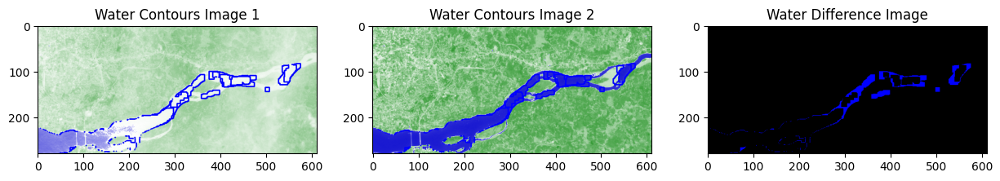

Rate of Water Difference: 2.47%
1/1 [==============================] - 0s 112ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 47ms/step
CNN Prediction for Image 2: 1.0


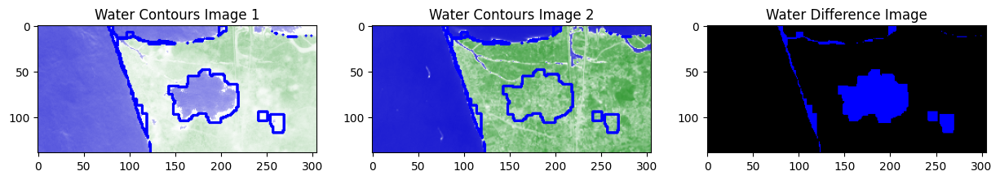

Rate of Water Difference: 10.32%
1/1 [==============================] - 0s 44ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 54ms/step
CNN Prediction for Image 2: 1.0


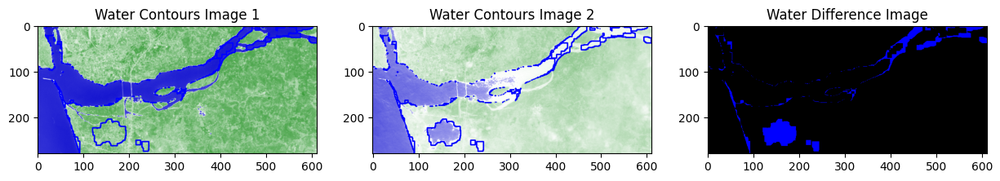

Rate of Water Difference: 5.02%
1/1 [==============================] - 0s 45ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 46ms/step
CNN Prediction for Image 2: 1.0


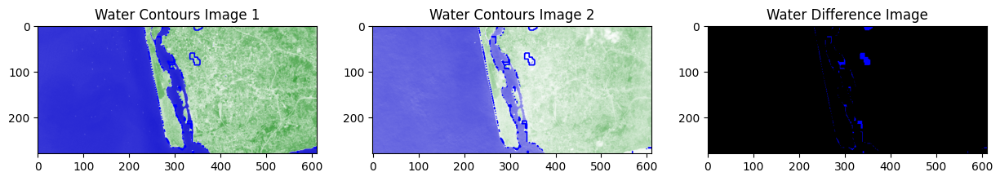

Rate of Water Difference: 0.79%
1/1 [==============================] - 0s 50ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 63ms/step
CNN Prediction for Image 2: 1.0


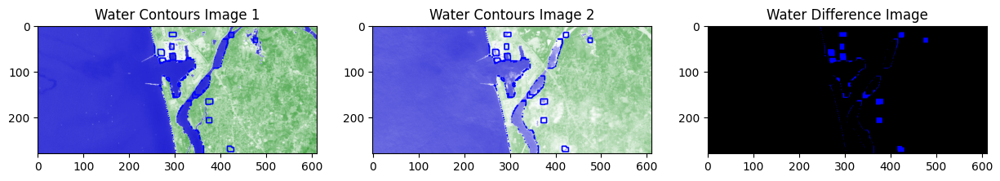

Rate of Water Difference: 1.47%
1/1 [==============================] - 0s 49ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 87ms/step
CNN Prediction for Image 2: 1.0


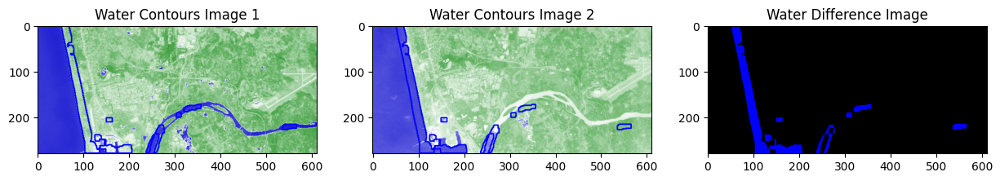

Rate of Water Difference: 4.91%
1/1 [==============================] - 0s 87ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 78ms/step
CNN Prediction for Image 2: 1.0


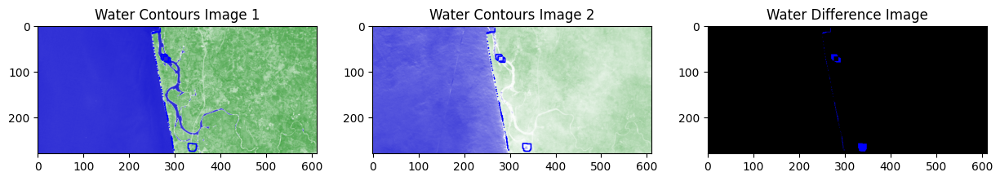

Rate of Water Difference: 0.41%
1/1 [==============================] - 0s 66ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 66ms/step
CNN Prediction for Image 2: 1.0


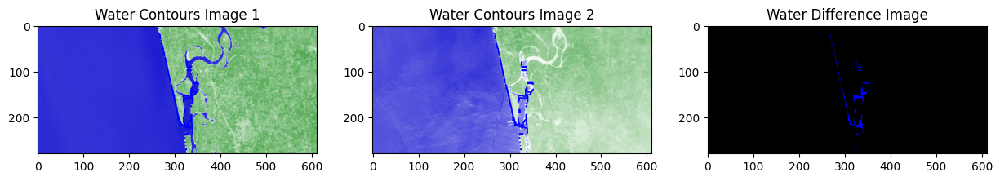

Rate of Water Difference: 0.56%
1/1 [==============================] - 0s 48ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 53ms/step
CNN Prediction for Image 2: 1.0


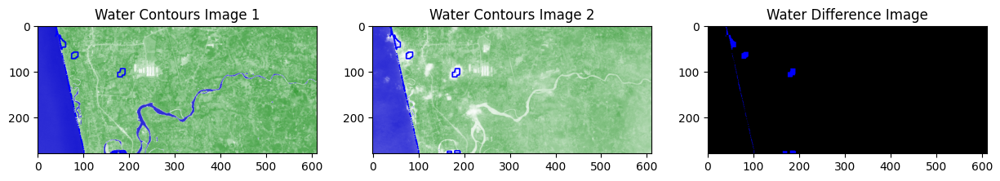

Rate of Water Difference: 0.62%
1/1 [==============================] - 0s 64ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 58ms/step
CNN Prediction for Image 2: 1.0


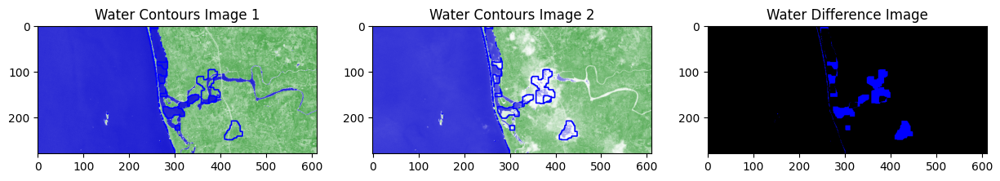

Rate of Water Difference: 3.45%
1/1 [==============================] - 0s 51ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 55ms/step
CNN Prediction for Image 2: 1.0


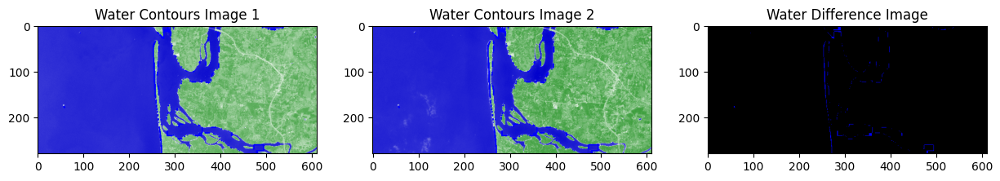

Rate of Water Difference: 0.56%
1/1 [==============================] - 0s 77ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 103ms/step
CNN Prediction for Image 2: 1.0


In [10]:
import cv2
import numpy as np
from skimage import color
import matplotlib.pyplot as plt
import os
import imageio
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None, model=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            filename1 = os.path.join(save_path, f'water_highlighted_1_{os.path.basename(image1_path)}')
            filename2 = os.path.join(save_path, f'water_highlighted_2_{os.path.basename(image2_path)}')
            filename_diff = os.path.join(save_path, f'water_difference_{os.path.basename(image1_path)}_{os.path.basename(image2_path)}')

            cv2.imwrite(filename1, cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename2, cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename_diff, cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        # If a model is provided, use it for predictions
        if model is not None:
            cnn_image1 = cv2.resize(image1, (224, 224))
            cnn_image1 = np.expand_dims(cnn_image1, axis=0)  # Add batch dimension
            cnn_prediction1 = model.predict(cnn_image1)
            print(f'CNN Prediction for Image 1: {cnn_prediction1[0][0]}')

            cnn_image2 = cv2.resize(image2, (224, 224))
            cnn_image2 = np.expand_dims(cnn_image2, axis=0)  # Add batch dimension
            cnn_prediction2 = model.predict(cnn_image2)
            print(f'CNN Prediction for Image 2: {cnn_prediction2[0][0]}')

        return water_difference_rate

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the path to the folder containing water-highlighted images
folder_path = "/content/drive/MyDrive/WaterHighlightedImages"  # Update with your folder path

# Load and preprocess data
images, labels = load_and_preprocess_data(folder_path)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Define the CNN model
model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(1, activation='sigmoid')
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the CNN model
model.fit(X_train, y_train, epochs=10, validation_data=(X_test, y_test))

# Save the trained model
model.save("/content/drive/MyDrive/water_change_detection_model.h5")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# Specify the path to save the water-highlighted images
save_path = "/content/drive/MyDrive/WaterHighlightedImages"

# Create the directory if it does not exist
os.makedirs(save_path, exist_ok=True)

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Iterate over pairs of images from the two folders
for i in range(min(len(image_files1), len(image_files2))):
    image_file1 = image_files1[i]
    image_file2 = image_files2[i]

    image1_path = os.path.join(folder_path1, image_file1)
    image2_path = os.path.join(folder_path2, image_file2)

    img1 = imageio.imread(image1_path)
    img2 = imageio.imread(image2_path)

    obia(img1, img2, ndwi_threshold=0.02, save_path=save_path, model=model)


In [12]:
import cv2
import numpy as np
import os
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import layers, models

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            filename1 = os.path.join(save_path, f'water_highlighted_1_{os.path.basename(image1_path)}')
            filename2 = os.path.join(save_path, f'water_highlighted_2_{os.path.basename(image2_path)}')
            filename_diff = os.path.join(save_path, f'water_difference_{os.path.basename(image1_path)}_{os.path.basename(image2_path)}')

            cv2.imwrite(filename1, cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename2, cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename_diff, cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        return water_difference_rate

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the path to the folder containing water-highlighted images
folder_path = "/content/drive/MyDrive/WaterHighlightedImages"  # Update with your folder path

# Load and preprocess data
images, labels = load_and_preprocess_data(folder_path)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Check if data is not empty before training
if len(X_train) > 0 and len(y_train) > 0:
    # Define CNN model
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # Binary classification output
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Train the model
    model.fit(X_train, y_train, epochs=10)

    # Evaluate the model
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Save the model for future use
    model.save("/content/drive/MyDrive/water_change_detection_model.h5")

else:
    print("Data is empty. Please check your dataset.")


Epoch 1/10
1/1 [==============================] - 1s 1s/step - loss: 10.8336 - accuracy: 0.0000e+00
Epoch 2/10
1/1 [==============================] - 0s 326ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 3/10
1/1 [==============================] - 0s 297ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 4/10
1/1 [==============================] - 0s 302ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 5/10
1/1 [==============================] - 0s 307ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 6/10
1/1 [==============================] - 0s 305ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 7/10
1/1 [==============================] - 0s 296ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 8/10
1/1 [==============================] - 0s 298ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 9/10
1/1 [==============================] - 0s 309ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 10/10
1/1 [==============================] - 0s 177ms/step - loss: 0.0000e+00 

Epoch 1/10
1/1 [==============================] - 1s 1s/step - loss: 4.1446e-13 - accuracy: 1.0000
Epoch 2/10
1/1 [==============================] - 0s 346ms/step - loss: 4.1446e-13 - accuracy: 1.0000
Epoch 3/10
1/1 [==============================] - 0s 458ms/step - loss: 4.1446e-13 - accuracy: 1.0000
Epoch 4/10
1/1 [==============================] - 1s 517ms/step - loss: 4.1446e-13 - accuracy: 1.0000
Epoch 5/10
1/1 [==============================] - 0s 493ms/step - loss: 4.1446e-13 - accuracy: 1.0000
Epoch 6/10
1/1 [==============================] - 0s 451ms/step - loss: 4.1446e-13 - accuracy: 1.0000
Epoch 7/10
1/1 [==============================] - 0s 440ms/step - loss: 4.1446e-13 - accuracy: 1.0000
Epoch 8/10
1/1 [==============================] - 0s 485ms/step - loss: 4.1446e-13 - accuracy: 1.0000
Epoch 9/10
1/1 [==============================] - 1s 503ms/step - loss: 4.1446e-13 - accuracy: 1.0000
Epoch 10/10
1/1 [==============================] - 0s 276ms/step - loss: 8.5851e-13 -

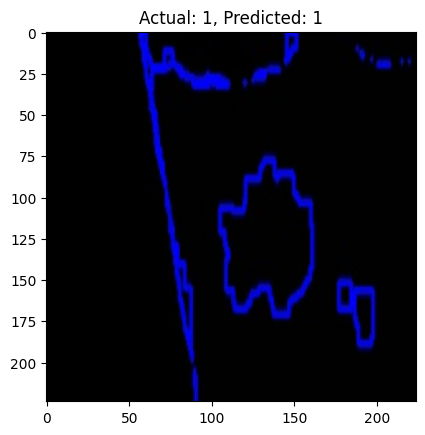

In [13]:
import cv2
import numpy as np
import os
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import layers, models
import matplotlib.pyplot as plt

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            filename1 = os.path.join(save_path, f'water_highlighted_1_{os.path.basename(image1_path)}')
            filename2 = os.path.join(save_path, f'water_highlighted_2_{os.path.basename(image2_path)}')
            filename_diff = os.path.join(save_path, f'water_difference_{os.path.basename(image1_path)}_{os.path.basename(image2_path)}')

            cv2.imwrite(filename1, cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename2, cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename_diff, cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        return water_difference_rate

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the path to the folder containing water-highlighted images
folder_path = "/content/drive/MyDrive/WaterHighlightedImages"  # Update with your folder path

# Load and preprocess data
images, labels = load_and_preprocess_data(folder_path)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Check if data is not empty before training
if len(X_train) > 0 and len(y_train) > 0:
    # Define CNN model
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # Binary classification output
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Train the model
    model.fit(X_train, y_train, epochs=10)

    # Evaluate the model
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Display some test images and predictions
    predictions = model.predict(X_test)
    for i in range(min(5, len(X_test))):
        plt.figure()
        plt.imshow(X_test[i])
        plt.title(f"Actual: {y_test[i]}, Predicted: {round(predictions[i][0])}")
        plt.show()

    # Save the model for future use
    model.save("/content/drive/MyDrive/water_change_detection_model.h5")

else:
    print("Data is empty. Please check your dataset.")


<ipython-input-14-2498d716e7d2>:127: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-14-2498d716e7d2>:128: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


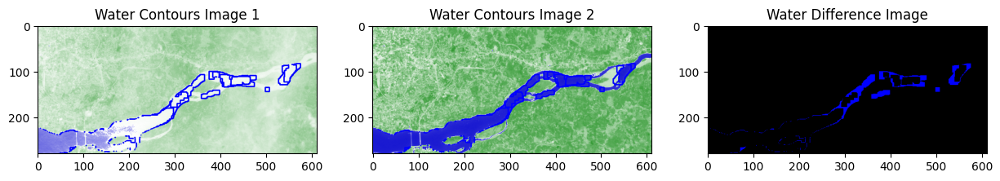

Rate of Water Difference: 2.47%
1/1 [==============================] - 0s 94ms/step
CNN Prediction for Image 1: 0.9997372031211853
1/1 [==============================] - 0s 45ms/step
CNN Prediction for Image 2: 0.9997372031211853


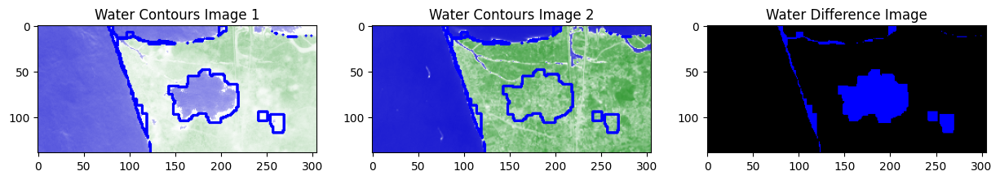

Rate of Water Difference: 10.32%
1/1 [==============================] - 0s 100ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 40ms/step
CNN Prediction for Image 2: 1.0


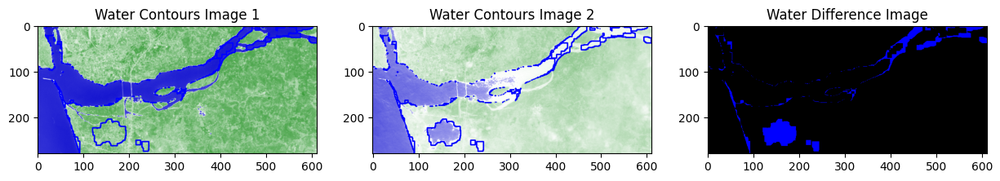

Rate of Water Difference: 5.02%


1/1 [==============================] - 0s 161ms/step
CNN Prediction for Image 1: 0.987898588180542
1/1 [==============================] - 0s 62ms/step
CNN Prediction for Image 2: 0.987898588180542


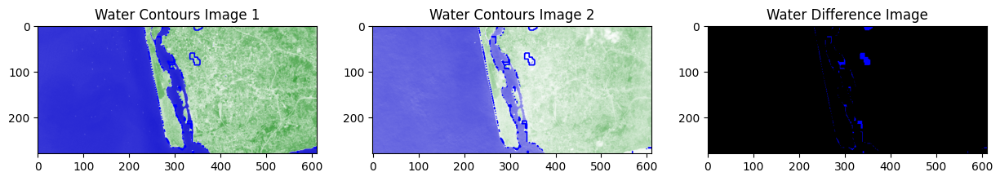

Rate of Water Difference: 0.79%


1/1 [==============================] - 0s 108ms/step
CNN Prediction for Image 1: 0.9890697598457336
1/1 [==============================] - 0s 47ms/step
CNN Prediction for Image 2: 0.9890697598457336


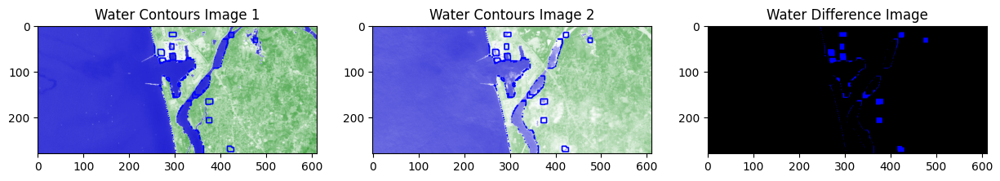

Rate of Water Difference: 1.47%
1/1 [==============================] - 0s 115ms/step
CNN Prediction for Image 1: 0.993769645690918
1/1 [==============================] - 0s 43ms/step
CNN Prediction for Image 2: 0.993769645690918


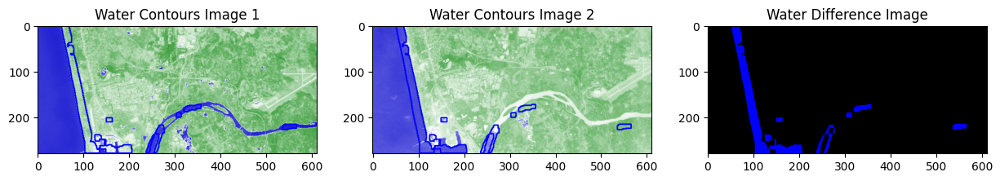

Rate of Water Difference: 4.91%
1/1 [==============================] - 0s 111ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 42ms/step
CNN Prediction for Image 2: 1.0


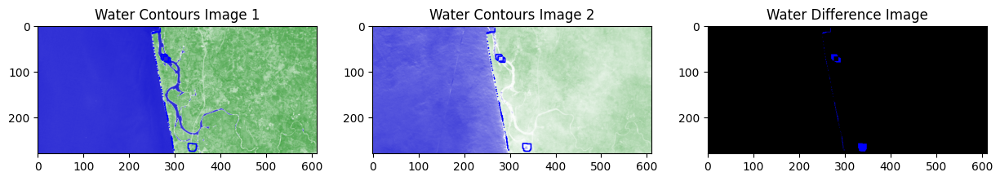

Rate of Water Difference: 0.41%
1/1 [==============================] - 0s 167ms/step
CNN Prediction for Image 1: 0.7051777839660645
1/1 [==============================] - 0s 71ms/step
CNN Prediction for Image 2: 0.7051777839660645


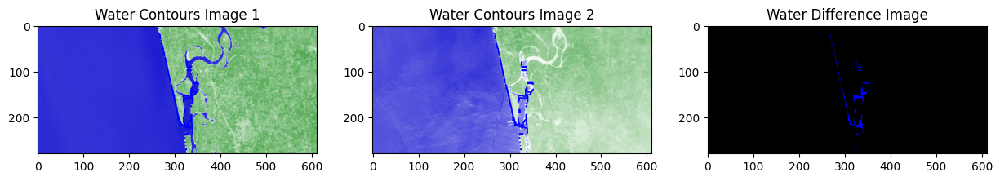

Rate of Water Difference: 0.56%
1/1 [==============================] - 0s 99ms/step
CNN Prediction for Image 1: 1.0
1/1 [==============================] - 0s 43ms/step
CNN Prediction for Image 2: 1.0


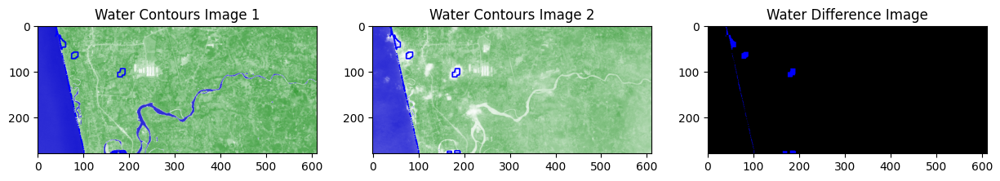

Rate of Water Difference: 0.62%
1/1 [==============================] - 0s 244ms/step
CNN Prediction for Image 1: 0.9995405077934265
1/1 [==============================] - 0s 50ms/step
CNN Prediction for Image 2: 0.9995405077934265


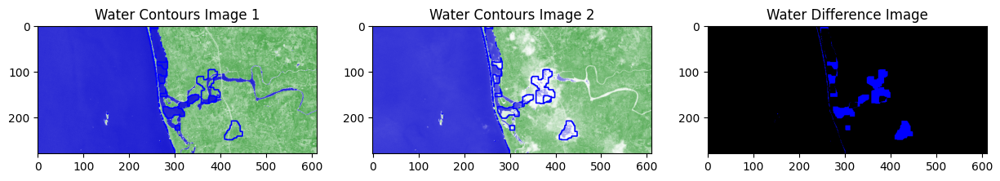

Rate of Water Difference: 3.45%
1/1 [==============================] - 0s 311ms/step
CNN Prediction for Image 1: 0.9500219821929932
1/1 [==============================] - 0s 168ms/step
CNN Prediction for Image 2: 0.9500219821929932


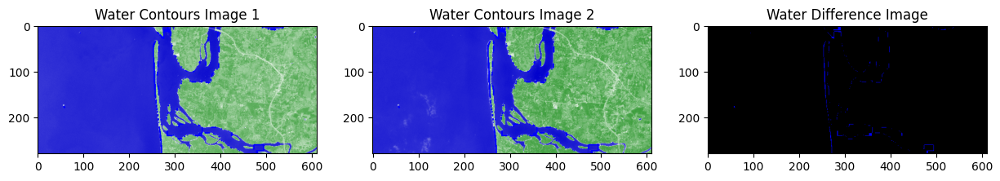

Rate of Water Difference: 0.56%
1/1 [==============================] - 0s 114ms/step
CNN Prediction for Image 1: 0.2310105562210083
1/1 [==============================] - 0s 52ms/step
CNN Prediction for Image 2: 0.2310105562210083


In [14]:
import cv2
import numpy as np
import os
from skimage import color
import matplotlib.pyplot as plt
import imageio
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            filename1 = os.path.join(save_path, f'water_highlighted_1_{os.path.basename(image1_path)}')
            filename2 = os.path.join(save_path, f'water_highlighted_2_{os.path.basename(image2_path)}')
            filename_diff = os.path.join(save_path, f'water_difference_{os.path.basename(image1_path)}_{os.path.basename(image2_path)}')

            cv2.imwrite(filename1, cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename2, cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename_diff, cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        return water_difference_rate, water_highlighted

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# Specify the path to save the water-highlighted images
save_path = "/content/drive/MyDrive/WaterHighlightedImages"

# Create the directory if it does not exist
os.makedirs(save_path, exist_ok=True)

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Iterate over pairs of images from the two folders
for i in range(min(len(image_files1), len(image_files2))):
    image_file1 = image_files1[i]
    image_file2 = image_files2[i]

    image1_path = os.path.join(folder_path1, image_file1)
    image2_path = os.path.join(folder_path2, image_file2)

    img1 = imageio.imread(image1_path)
    img2 = imageio.imread(image2_path)

    water_difference_rate, water_highlighted = obia(img1, img2, ndwi_threshold=0.02, save_path=save_path)

    # Load the trained CNN model
    cnn_model = models.load_model("/content/drive/MyDrive/water_change_detection_model.h5")

    # Prepare images for CNN prediction
    cnn_image1 = cv2.resize(water_highlighted, (224, 224))
    cnn_image1 = np.expand_dims(cnn_image1, axis=0)  # Add batch dimension
    cnn_prediction1 = cnn_model.predict(cnn_image1)
    print(f'CNN Prediction for Image 1: {cnn_prediction1[0][0]}')

    cnn_image2 = cv2.resize(water_highlighted, (224, 224))
    cnn_image2 = np.expand_dims(cnn_image2, axis=0)  # Add batch dimension
    cnn_prediction2 = cnn_model.predict(cnn_image2)
    print(f'CNN Prediction for Image 2: {cnn_prediction2[0][0]}')


In [15]:
import cv2
import numpy as np
import os
from skimage import color
import matplotlib.pyplot as plt
import imageio
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None, model=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            filename1 = os.path.join(save_path, f'water_highlighted_1_{os.path.basename(image1_path)}')
            filename2 = os.path.join(save_path, f'water_highlighted_2_{os.path.basename(image2_path)}')
            filename_diff = os.path.join(save_path, f'water_difference_{os.path.basename(image1_path)}_{os.path.basename(image2_path)}')

            cv2.imwrite(filename1, cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename2, cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename_diff, cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        # If a model is provided, use it for predictions
        if model is not None:
            cnn_image1 = cv2.resize(image1, (224, 224))
            cnn_image1 = np.expand_dims(cnn_image1, axis=0)  # Add batch dimension
            cnn_prediction1 = model.predict(cnn_image1)
            print(f'CNN Prediction for Image 1: {cnn_prediction1[0][0]}')

            cnn_image2 = cv2.resize(image2, (224, 224))
            cnn_image2 = np.expand_dims(cnn_image2, axis=0)  # Add batch dimension
            cnn_prediction2 = model.predict(cnn_image2)
            print(f'CNN Prediction for Image 2: {cnn_prediction2[0][0]}')

        return water_difference_rate

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the path to the folder containing water-highlighted images
folder_path = "/content/drive/MyDrive/WaterHighlightedImages"  # Update with your folder path

# Load and preprocess data
images, labels = load_and_preprocess_data(folder_path)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Define the CNN model
model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(1, activation='sigmoid')
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the CNN model on all the data
model.fit(images, labels, epochs=10)

# Save the trained model
model.save("/content/drive/MyDrive/water_change_detection_model.h5")

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# Specify the path to save the water-highlighted images
save_path = "/content/drive/MyDrive/WaterHighlightedImages"

# Create the directory if it does not exist
os.makedirs(save_path, exist_ok=True)

# Iterate over pairs of images from the two folders
for i in range(min(len(X_test), len(y_test))):
    image_file1 = X_test[i]
    image_file2 = y_test[i]

    image1_path = os.path.join(folder_path1, image_file1)
    image2_path = os.path.join(folder_path2, image_file2)

    img1 = imageio.imread(image1_path)
    img2 = imageio.imread(image2_path)

    obia(img1, img2, ndwi_threshold=0.02, save_path=save_path, model=model)


Epoch 1/10
1/1 [==============================] - 2s 2s/step - loss: 0.9121 - accuracy: 0.3333
Epoch 2/10
1/1 [==============================] - 0s 421ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 3/10
1/1 [==============================] - 0s 426ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 4/10
1/1 [==============================] - 1s 584ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 5/10
1/1 [==============================] - 1s 634ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 6/10
1/1 [==============================] - 1s 605ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 7/10
1/1 [==============================] - 1s 632ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 8/10
1/1 [==============================] - 1s 632ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 9/10
1/1 [==============================] - 1s 629ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 10/10
1/1 [==============================] - 1s 598ms/step - loss: 0.0000e+00 - acc

TypeError: join() argument must be str, bytes, or os.PathLike object, not 'ndarray'

<ipython-input-16-2aaa542a56f4>:141: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-16-2aaa542a56f4>:142: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


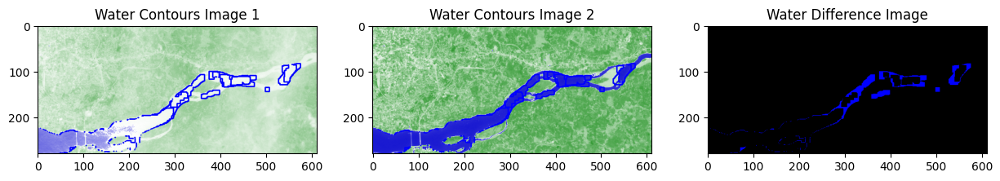

Rate of Water Difference: 2.47%


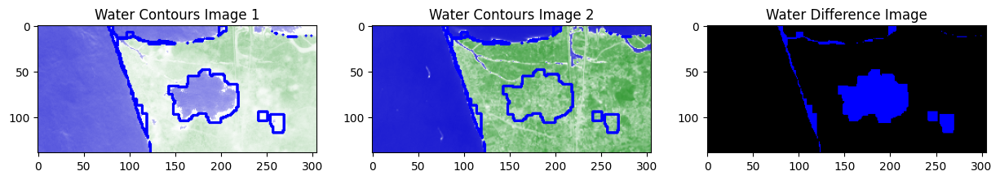

Rate of Water Difference: 10.32%


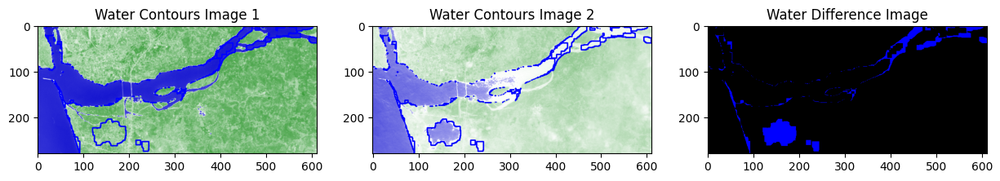

Rate of Water Difference: 5.02%


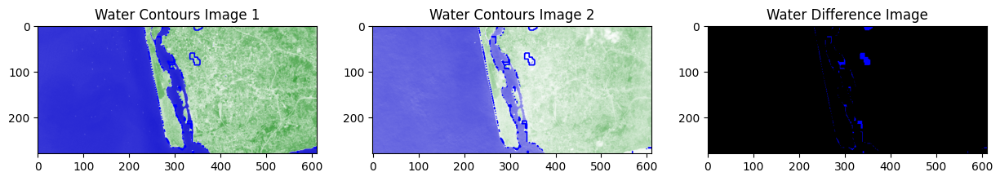

Rate of Water Difference: 0.79%


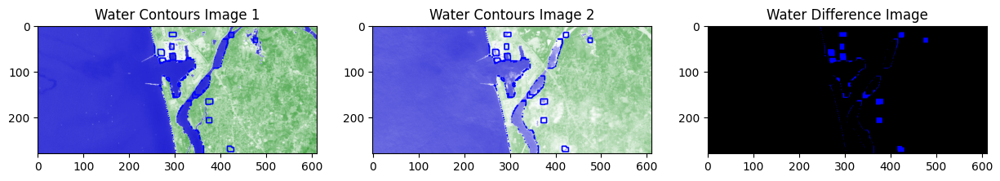

Rate of Water Difference: 1.47%


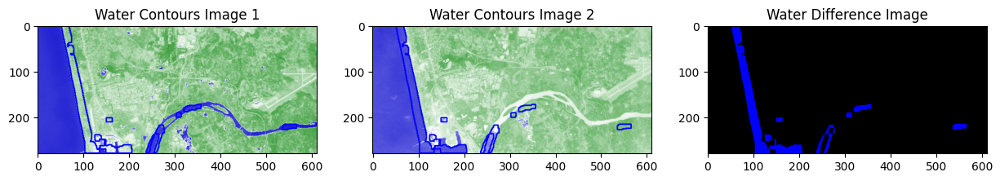

Rate of Water Difference: 4.91%


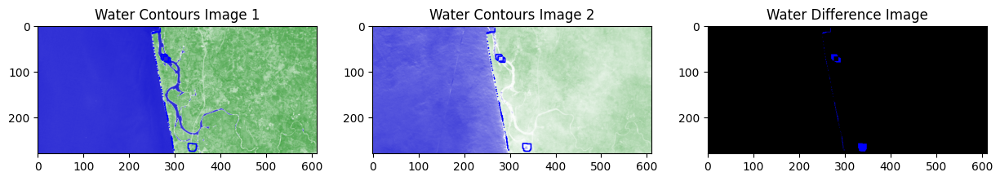

Rate of Water Difference: 0.41%


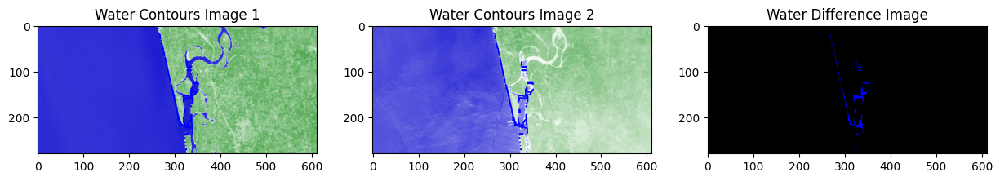

Rate of Water Difference: 0.56%


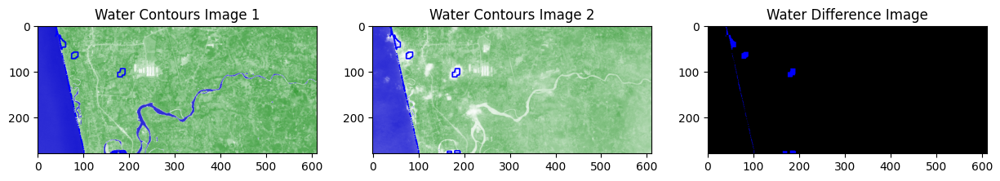

Rate of Water Difference: 0.62%


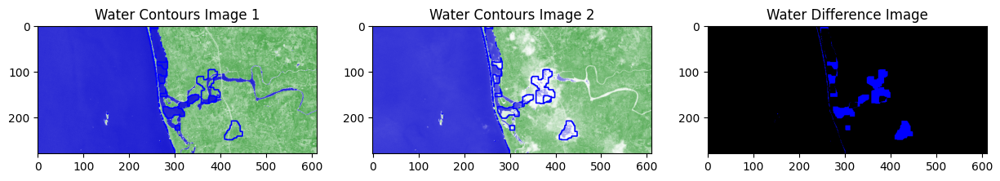

Rate of Water Difference: 3.45%


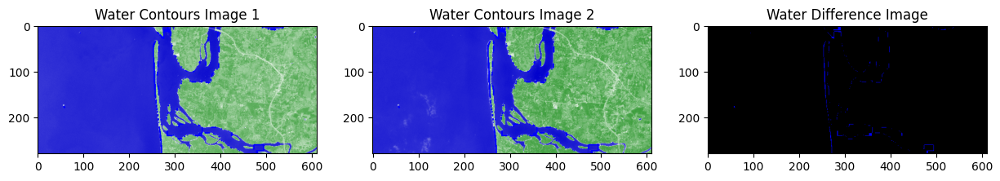

Rate of Water Difference: 0.56%
Epoch 1/10
1/1 [==============================] - 1s 1s/step - loss: 0.2547 - accuracy: 1.0000
Epoch 2/10
1/1 [==============================] - 0s 366ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 3/10
1/1 [==============================] - 0s 349ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 4/10
1/1 [==============================] - 0s 387ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 5/10
1/1 [==============================] - 0s 359ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 6/10
1/1 [==============================] - 0s 390ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 7/10
1/1 [==============================] - 0s 387ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 8/10
1/1 [==============================] - 0s 349ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 9/10
1/1 [==============================] - 0s 366ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 10/10
1/1 [==============================] - 0s 379

1/1 [==============================] - 0s 184ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Test accuracy: 1.0


In [16]:
import cv2
import numpy as np
import os
import imageio
import matplotlib.pyplot as plt
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None, model=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            filename1 = os.path.join(save_path, f'water_highlighted_1_{os.path.basename(image1_path)}')
            filename2 = os.path.join(save_path, f'water_highlighted_2_{os.path.basename(image2_path)}')
            filename_diff = os.path.join(save_path, f'water_difference_{os.path.basename(image1_path)}_{os.path.basename(image2_path)}')

            cv2.imwrite(filename1, cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename2, cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename_diff, cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        # If a model is provided, use it for predictions
        if model is not None:
            cnn_image1 = cv2.resize(image1, (224, 224))
            cnn_image1 = np.expand_dims(cnn_image1, axis=0)  # Add batch dimension
            cnn_prediction1 = model.predict(cnn_image1)
            print(f'CNN Prediction for Image 1: {cnn_prediction1[0][0]}')

            cnn_image2 = cv2.resize(image2, (224, 224))
            cnn_image2 = np.expand_dims(cnn_image2, axis=0)  # Add batch dimension
            cnn_prediction2 = model.predict(cnn_image2)
            print(f'CNN Prediction for Image 2: {cnn_prediction2[0][0]}')

        return water_difference_rate

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# Specify the path to save the water-highlighted images
save_path = "/content/drive/MyDrive/WaterHighlightedImages"

# Create the directory if it does not exist
os.makedirs(save_path, exist_ok=True)

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Iterate over pairs of images from the two folders
for i in range(min(len(image_files1), len(image_files2))):
    image_file1 = image_files1[i]
    image_file2 = image_files2[i]

    image1_path = os.path.join(folder_path1, image_file1)
    image2_path = os.path.join(folder_path2, image_file2)

    img1 = imageio.imread(image1_path)
    img2 = imageio.imread(image2_path)

    obia(img1, img2, ndwi_threshold=0.02, save_path=save_path)

# Load and preprocess data for CNN
images, labels = load_and_preprocess_data(save_path)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Check if data is not empty before training
if len(X_train) > 0 and len(y_train) > 0:
    # Define CNN model
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # Binary classification output
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Train the model
    model.fit(X_train, y_train, epochs=10)

    # Evaluate the model
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Save the model for future use
    model.save("/content/drive/MyDrive/water_change_detection_model.h5")

else:
    print("Data is empty. Please check your dataset.")


<ipython-input-17-471e7ec2757d>:141: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img1 = imageio.imread(image1_path)
<ipython-input-17-471e7ec2757d>:142: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img2 = imageio.imread(image2_path)


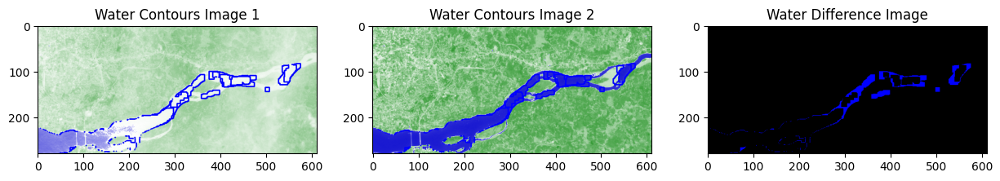

Rate of Water Difference: 2.47%


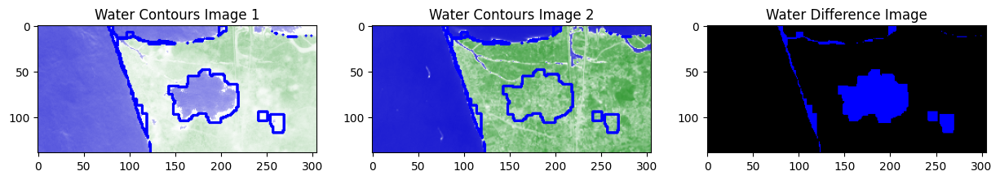

Rate of Water Difference: 10.32%


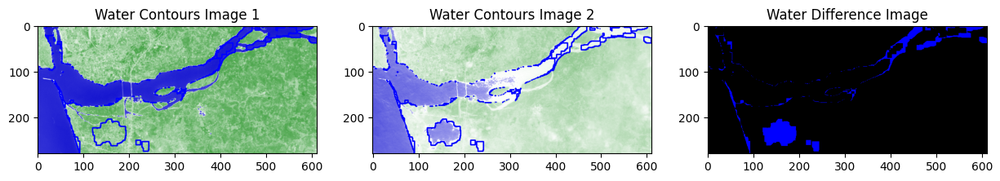

Rate of Water Difference: 5.02%


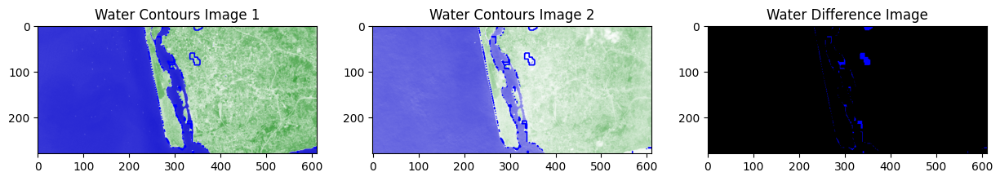

Rate of Water Difference: 0.79%


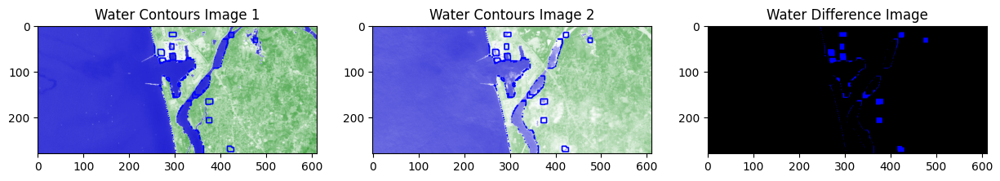

Rate of Water Difference: 1.47%


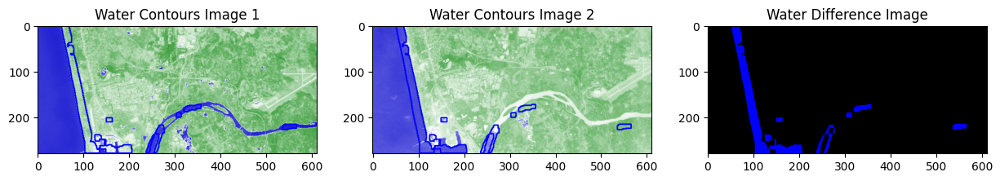

Rate of Water Difference: 4.91%


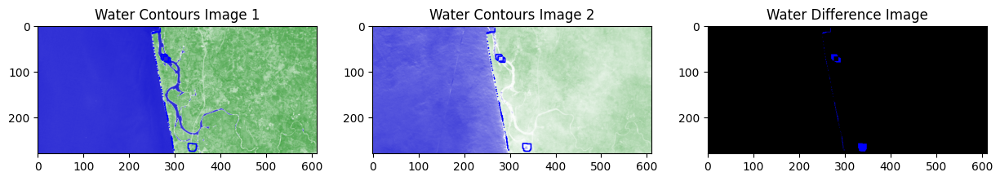

Rate of Water Difference: 0.41%


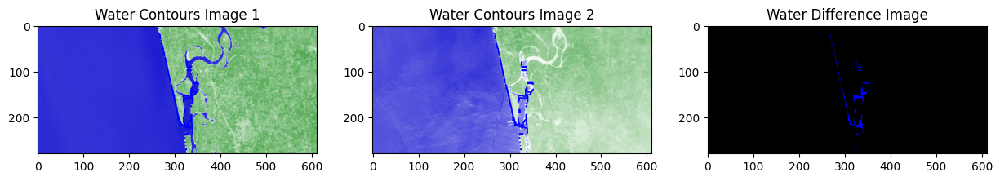

Rate of Water Difference: 0.56%


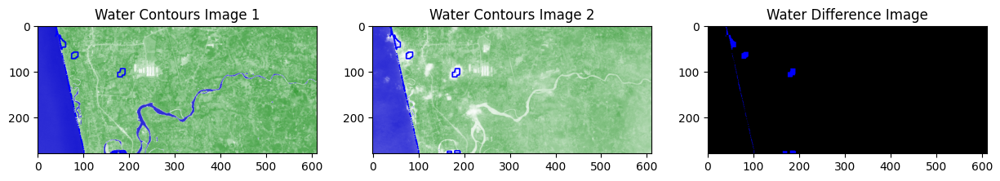

Rate of Water Difference: 0.62%


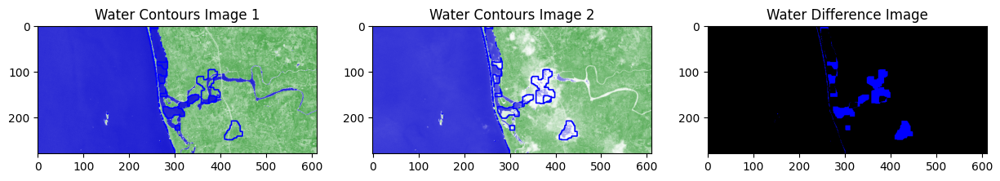

Rate of Water Difference: 3.45%


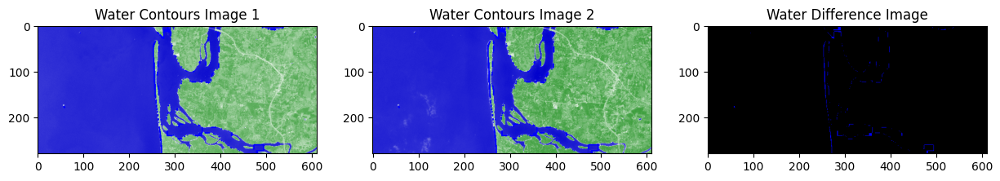

Rate of Water Difference: 0.56%
Epoch 1/10
1/1 [==============================] - 1s 1s/step - loss: 0.0440 - accuracy: 1.0000
Epoch 2/10
1/1 [==============================] - 0s 383ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 3/10
1/1 [==============================] - 0s 360ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 4/10
1/1 [==============================] - 0s 362ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 5/10
1/1 [==============================] - 0s 363ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 6/10
1/1 [==============================] - 0s 383ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 7/10
1/1 [==============================] - 0s 359ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 8/10
1/1 [==============================] - 0s 368ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 9/10
1/1 [==============================] - 0s 368ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 10/10
1/1 [==============================] - 0s 362

1/1 [==============================] - 0s 201ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Test accuracy: 1.0


In [17]:
import cv2
import numpy as np
import os
import imageio
import matplotlib.pyplot as plt
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Function to calculate the rate of difference in water regions
def calculate_water_difference_rate(water_mask):
    total_pixels = water_mask.size
    different_pixels = np.count_nonzero(water_mask == 255)
    difference_rate = (different_pixels / total_pixels) * 100
    return difference_rate

# Function to perform object-based image analysis (OBIA) using NDWI
def obia(image1, image2, ndwi_threshold=0.02, save_path=None, model=None):
    # Ensure both images have the same dimensions
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])
    image1 = cv2.resize(image1, (min_width, min_height))
    image2 = cv2.resize(image2, (min_width, min_height))

    # Check if the images have 3 channels (RGB)
    if image1.shape[2] == 3 and image2.shape[2] == 3:
        # Convert images to HSV color space
        hsv1 = cv2.cvtColor(image1, cv2.COLOR_RGB2HSV)
        hsv2 = cv2.cvtColor(image2, cv2.COLOR_RGB2HSV)

        # Define range of blue color in HSV
        lower_blue = np.array([90, 50, 50])
        upper_blue = np.array([130, 255, 255])

        # Create masks for blue regions in HSV
        blue_mask1 = cv2.inRange(hsv1, lower_blue, upper_blue)
        blue_mask2 = cv2.inRange(hsv2, lower_blue, upper_blue)

        # Combine NDWI and HSV blue masks
        water_mask1 = cv2.bitwise_or(blue_mask1, (ndwi(image1) >= ndwi_threshold).astype(np.uint8) * 255)
        water_mask2 = cv2.bitwise_or(blue_mask2, (ndwi(image2) >= ndwi_threshold).astype(np.uint8) * 255)

        # Perform morphological operations for refinement
        kernel = np.ones((10, 10), np.uint8)  # Larger kernel for closing
        water_mask1 = cv2.morphologyEx(water_mask1, cv2.MORPH_CLOSE, kernel)
        water_mask2 = cv2.morphologyEx(water_mask2, cv2.MORPH_CLOSE, kernel)

        # Highlight water changes in blue
        water_difference = cv2.absdiff(water_mask1, water_mask2)
        water_highlighted = np.zeros_like(image2)
        water_highlighted[water_difference == 255, 2] = 255  # Set the blue channel based on the water difference

        # Find contours of the water difference
        contours, _ = cv2.findContours(water_difference, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original images
        water_contour1 = cv2.drawContours(image1.copy(), contours, -1, (0, 0, 255), 2)
        water_contour2 = cv2.drawContours(image2.copy(), contours, -1, (0, 0, 255), 2)

        # Save the water-highlighted images
        if save_path is not None:
            filename1 = os.path.join(save_path, f'water_highlighted_1_{os.path.basename(image1_path)}')
            filename2 = os.path.join(save_path, f'water_highlighted_2_{os.path.basename(image2_path)}')
            filename_diff = os.path.join(save_path, f'water_difference_{os.path.basename(image1_path)}_{os.path.basename(image2_path)}')

            cv2.imwrite(filename1, cv2.cvtColor(water_contour1, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename2, cv2.cvtColor(water_contour2, cv2.COLOR_RGB2BGR))
            cv2.imwrite(filename_diff, cv2.cvtColor(water_highlighted, cv2.COLOR_RGB2BGR))

        # Display the images with contours
        plt.figure(figsize=(15, 6))
        plt.subplot(131), plt.imshow(water_contour1), plt.title('Water Contours Image 1')
        plt.subplot(132), plt.imshow(water_contour2), plt.title('Water Contours Image 2')
        plt.subplot(133), plt.imshow(water_highlighted), plt.title('Water Difference Image')
        plt.show()

        # Calculate and print the rate of difference for water
        water_difference_rate = calculate_water_difference_rate(water_difference)
        print(f"Rate of Water Difference: {water_difference_rate:.2f}%")

        # If a model is provided, use it for predictions
        if model is not None:
            cnn_image1 = cv2.resize(image1, (224, 224))
            cnn_image1 = np.expand_dims(cnn_image1, axis=0)  # Add batch dimension
            cnn_prediction1 = model.predict(cnn_image1)
            print(f'CNN Prediction for Image 1: {cnn_prediction1[0][0]}')

            cnn_image2 = cv2.resize(image2, (224, 224))
            cnn_image2 = np.expand_dims(cnn_image2, axis=0)  # Add batch dimension
            cnn_prediction2 = model.predict(cnn_image2)
            print(f'CNN Prediction for Image 2: {cnn_prediction2[0][0]}')

        return water_difference_rate

    else:
        print("Images do not have the expected number of channels (RGB). Please check your input images.")

# NDWI function
def ndwi(image):
    return (image[:, :, 1].astype(float) - image[:, :, 2]) / (image[:, :, 1] + image[:, :, 2])

# Function to load and preprocess images
def load_and_preprocess_data(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.jpg')]
    images = []
    labels = []

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (224, 224))
        images.append(img)

        label = int("water" in image_file.lower())
        labels.append(label)

    return np.array(images), np.array(labels)

# Specify the paths to the two folders containing TIFF images
folder_path1 = "/content/drive/MyDrive/Folder1"  # Update with your first folder path
folder_path2 = "/content/drive/MyDrive/Folder2"  # Update with your second folder path

# Specify the path to save the water-highlighted images
save_path = "/content/drive/MyDrive/WaterHighlightedImages"

# Create the directory if it does not exist
os.makedirs(save_path, exist_ok=True)

# List only TIFF files in each folder
image_files1 = [f for f in os.listdir(folder_path1) if f.lower().endswith('.tiff')]
image_files2 = [f for f in os.listdir(folder_path2) if f.lower().endswith('.tiff')]

# Iterate over pairs of images from the two folders
for i in range(min(len(image_files1), len(image_files2))):
    image_file1 = image_files1[i]
    image_file2 = image_files2[i]

    image1_path = os.path.join(folder_path1, image_file1)
    image2_path = os.path.join(folder_path2, image_file2)

    img1 = imageio.imread(image1_path)
    img2 = imageio.imread(image2_path)

    obia(img1, img2, ndwi_threshold=0.02, save_path=save_path)

# Load and preprocess data for CNN
images, labels = load_and_preprocess_data(save_path)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2, random_state=42)

# Check if data is not empty before training
if len(X_train) > 0 and len(y_train) > 0:
    # Define CNN model
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # Binary classification output
    ])

    # Compile the model
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Train the model
    model.fit(X_train, y_train, epochs=10)

    # Evaluate the model on the testing data
    test_loss, test_acc = model.evaluate(X_test, y_test)
    print(f'Test accuracy: {test_acc}')

    # Save the model for future use
    model.save("/content/drive/MyDrive/water_change_detection_model.h5")

else:
    print("Data is empty. Please check your dataset.")
